# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [7]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [8]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm -1)**2) 
    #### END CODE HERE ####
    return penalty

In [9]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -1. * torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [11]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [12]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [13]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.09466872252523899, critic loss: 1.9115709991455074


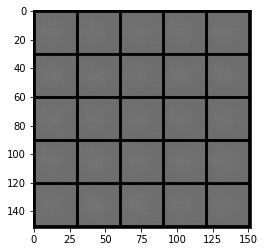

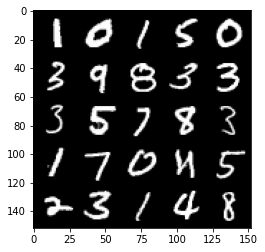

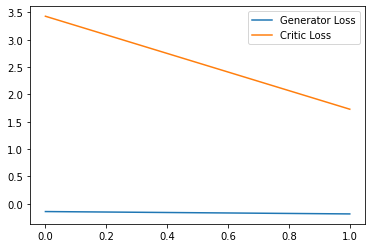

Step 100: Generator loss: 0.913802237957716, critic loss: -1.8283548102676865


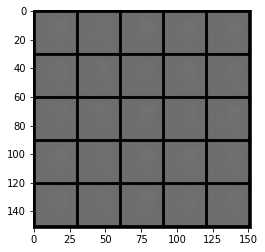

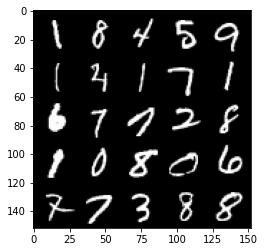

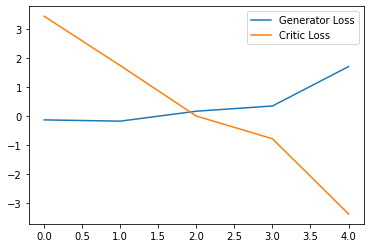

Step 150: Generator loss: 3.0354471930861475, critic loss: -10.791732812881468


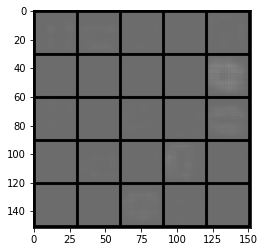

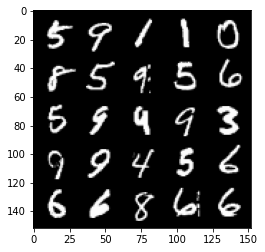

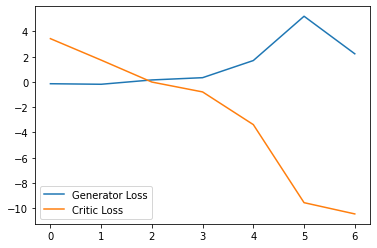

Step 200: Generator loss: -0.17567770704627036, critic loss: -25.179592048645024


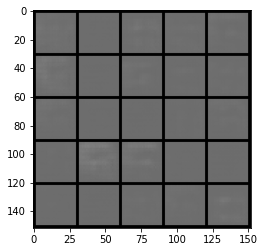

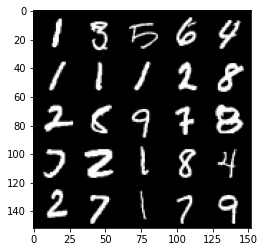

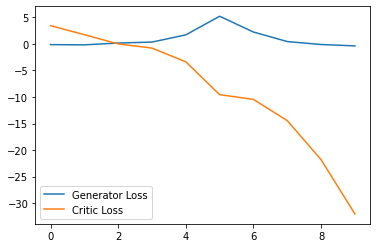

Step 250: Generator loss: -0.7316993020474911, critic loss: -56.12263827514649


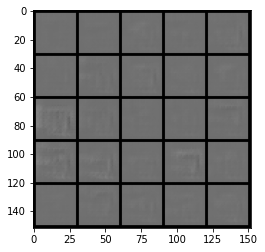

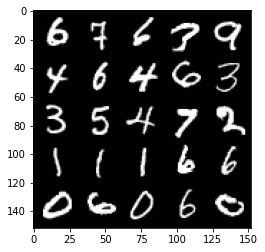

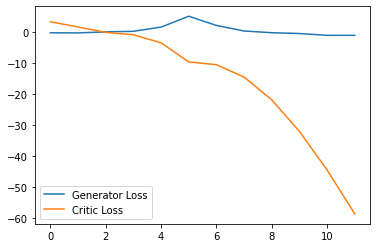

Step 300: Generator loss: 2.5404776072502138, critic loss: -99.85426397705082


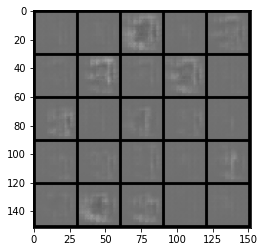

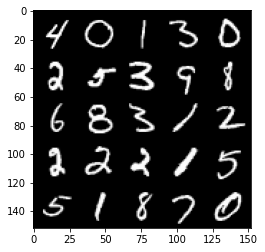

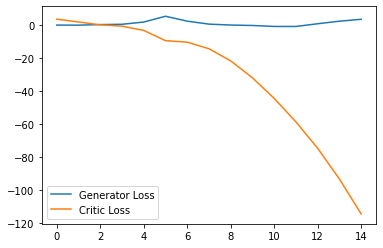

Step 350: Generator loss: 6.046126770973205, critic loss: -148.08341210937496


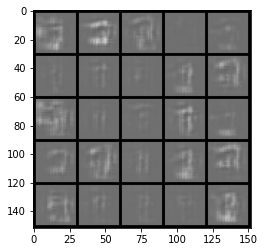

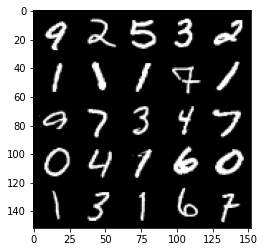

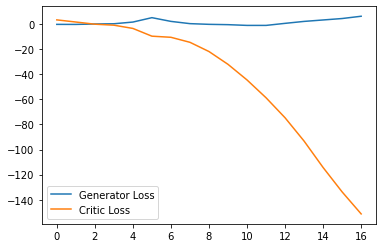

Step 400: Generator loss: 9.47588604927063, critic loss: -200.62980944824213


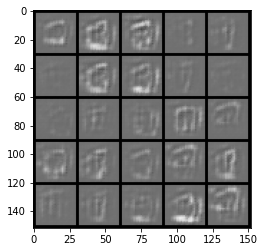

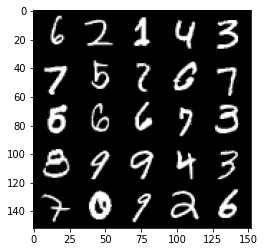

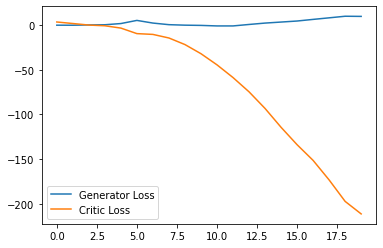

Step 450: Generator loss: -19.217648590803147, critic loss: -158.32519493103024


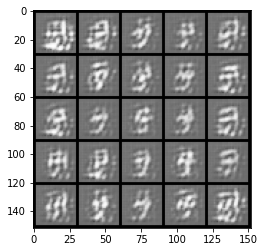

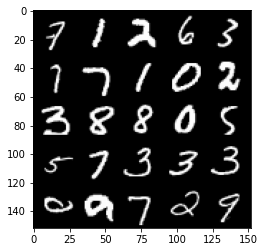

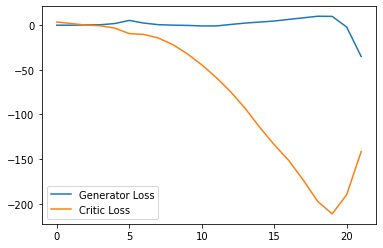

Step 500: Generator loss: 19.540646016597748, critic loss: -233.98033181762696


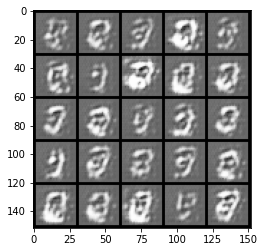

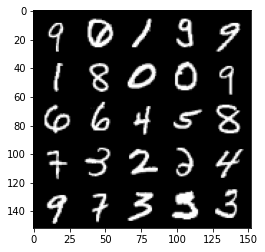

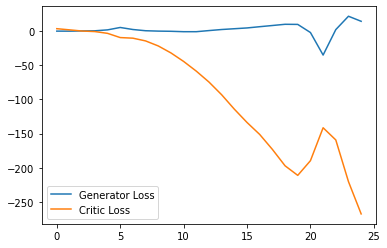

Step 550: Generator loss: 6.161157608032227, critic loss: -231.12968817138676


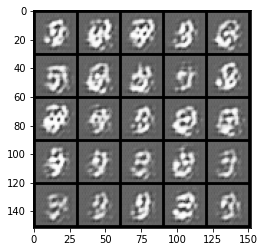

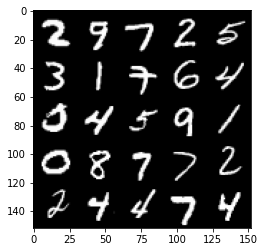

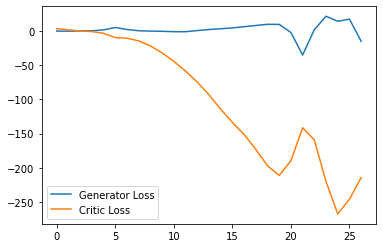

Step 600: Generator loss: 10.753850992321969, critic loss: -244.76963693237306


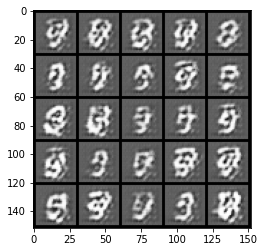

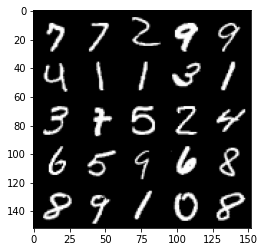

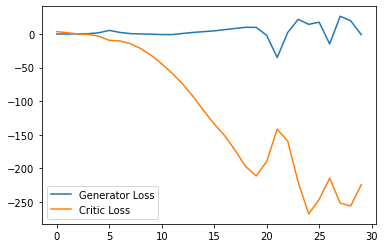

Step 650: Generator loss: -2.9297544991970064, critic loss: -218.1051915130615


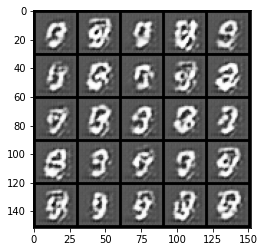

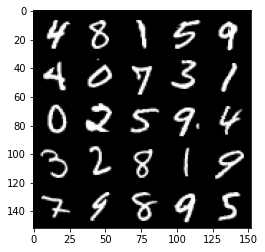

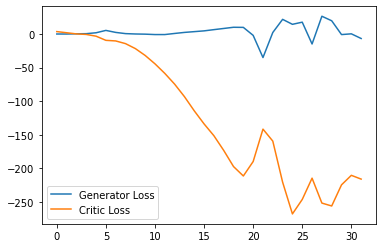

Step 700: Generator loss: -19.21419441103935, critic loss: -200.4662346496582


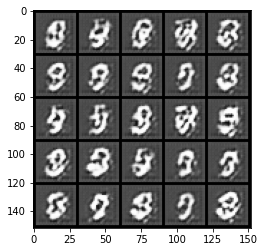

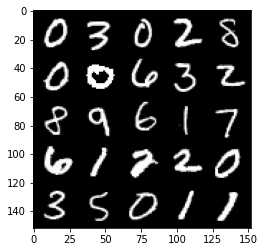

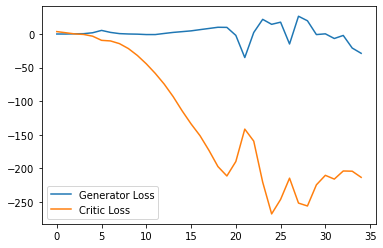

Step 750: Generator loss: -28.752677785158156, critic loss: -154.80700479888912


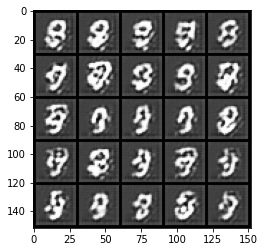

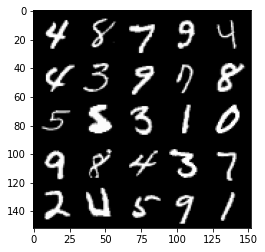

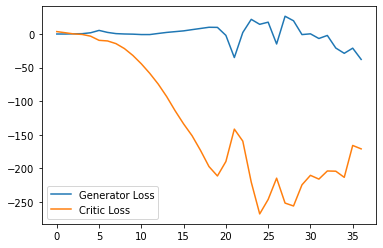

Step 800: Generator loss: -20.054442203044893, critic loss: -104.524139339447


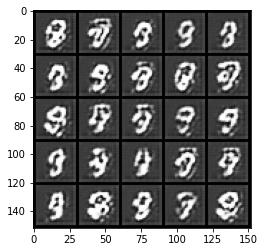

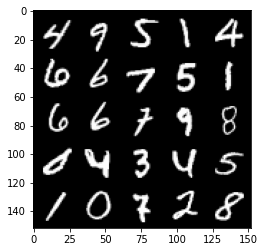

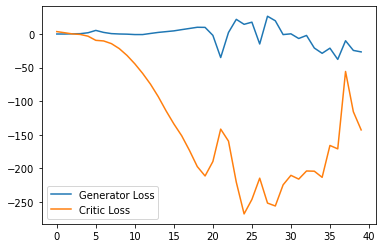

Step 850: Generator loss: -12.271724333763123, critic loss: -37.74061204910279


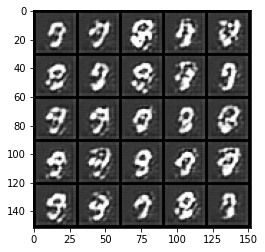

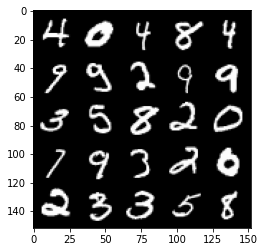

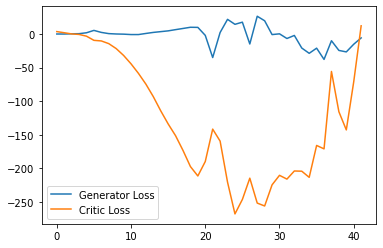

Step 900: Generator loss: -15.435873558521271, critic loss: -20.327316997528083


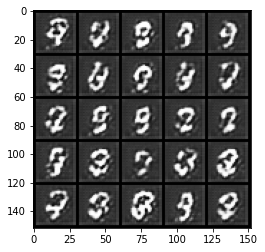

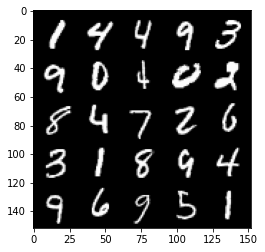

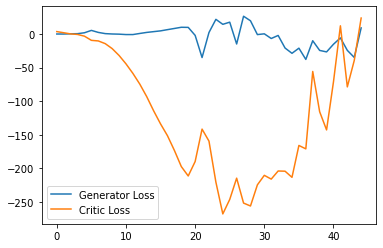

Step 950: Generator loss: 0.009838462173938751, critic loss: 12.027783624649043


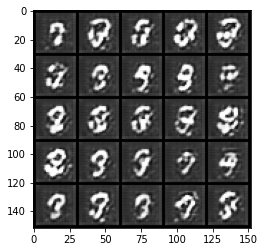

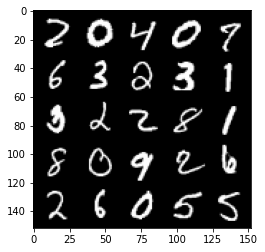

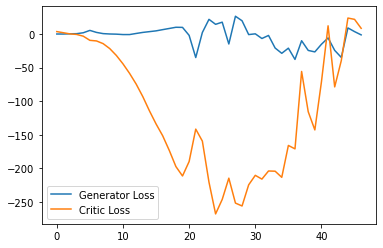

Step 1000: Generator loss: -3.0883523988723756, critic loss: 4.887080421447754


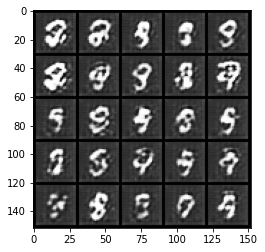

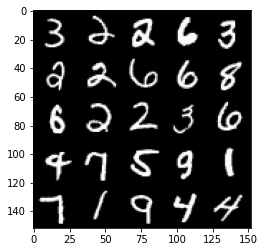

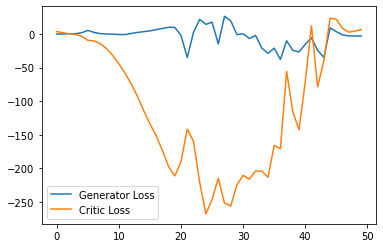

Step 1050: Generator loss: -2.5874594116210936, critic loss: 6.677284332275392


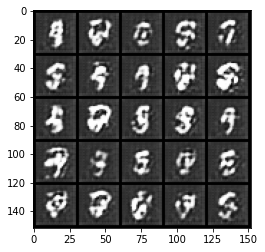

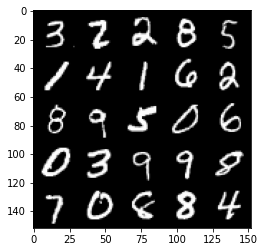

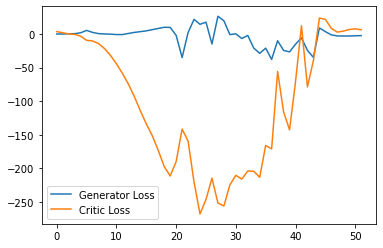

Step 1100: Generator loss: -2.1099213790893554, critic loss: 4.294775880813598



Step 2350: Generator loss: -0.042181296348571776, critic loss: -15.5863346862793


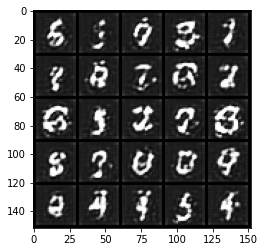

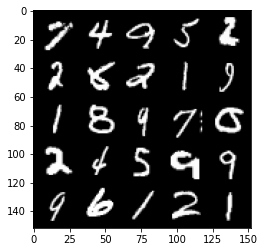

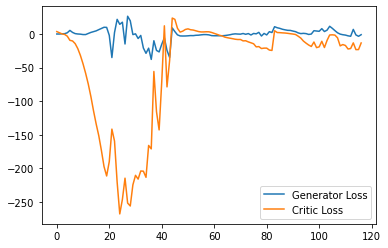

Step 2400: Generator loss: -0.6180059137940407, critic loss: -20.069031851768493


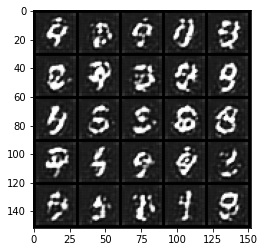

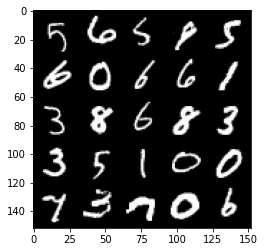

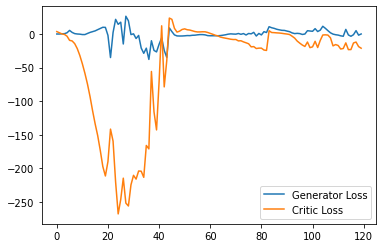

Step 2450: Generator loss: 1.3640088665485381, critic loss: -16.52270466995239


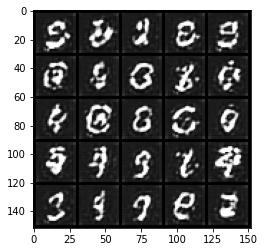

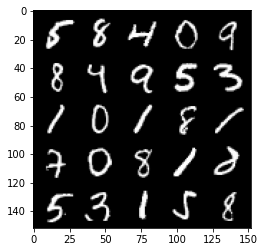

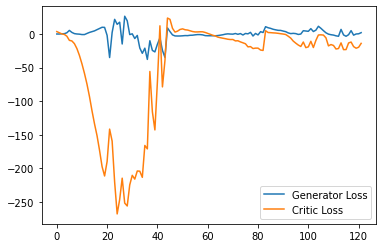

Step 2500: Generator loss: 1.6881409180164337, critic loss: -12.224728729248048


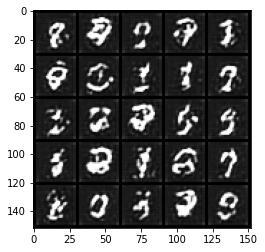

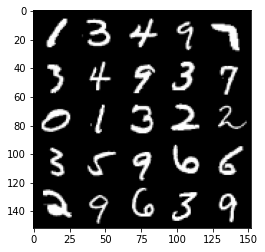

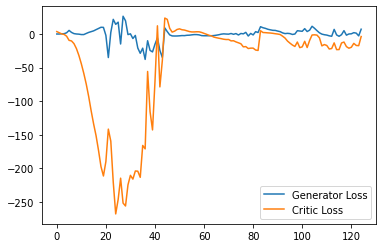

Step 2550: Generator loss: 0.3392755618691444, critic loss: -15.371926629543303


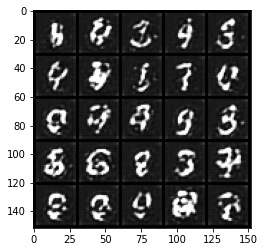

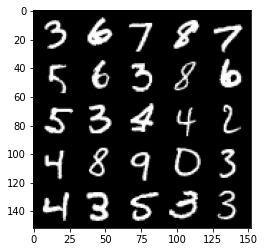

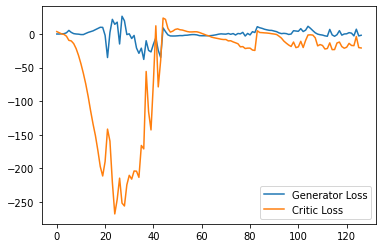

Step 2600: Generator loss: 7.247455768585205, critic loss: -2.8296972241401672


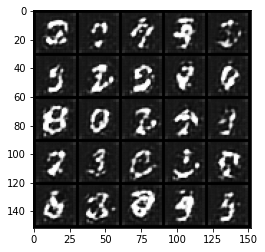

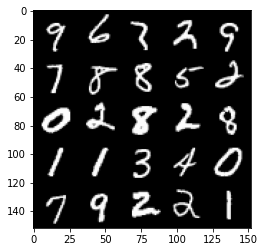

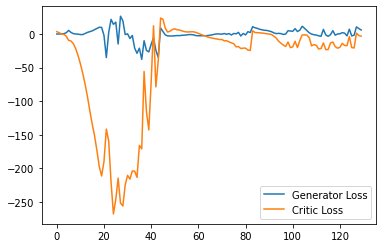

Step 2650: Generator loss: -3.722854480743408, critic loss: -18.618749554634096


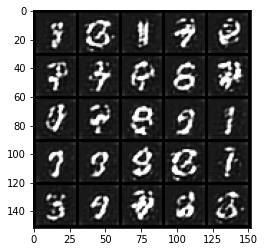

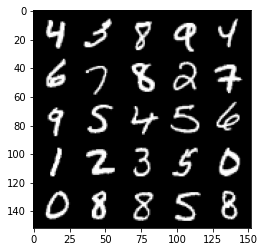

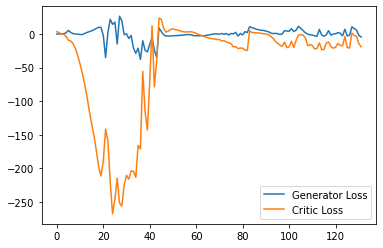

Step 2700: Generator loss: -5.1076004058122635, critic loss: -15.81699875092506


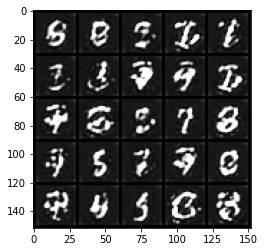

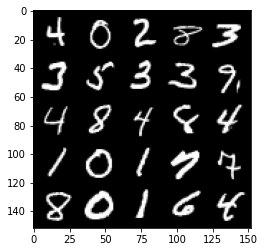

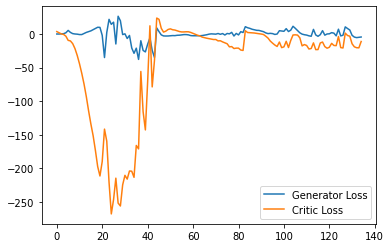

Step 2750: Generator loss: 4.816937881708145, critic loss: -1.8187999169826505


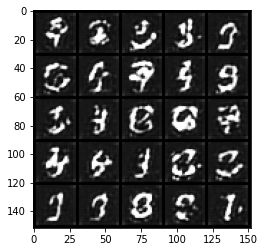

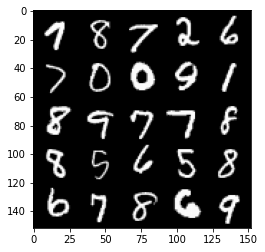

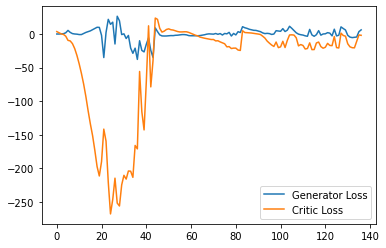

Step 2800: Generator loss: 1.6773864844441413, critic loss: -1.5128757433891298


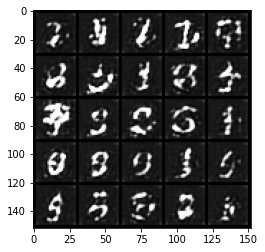

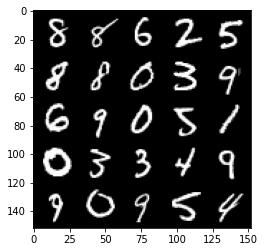

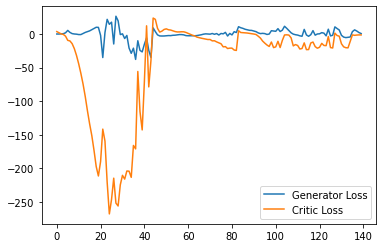

Step 6150: Generator loss: 15.276931285858154, critic loss: -2.6528413166999822


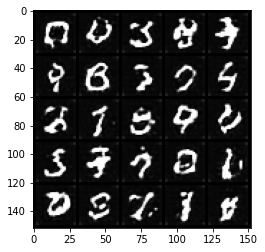

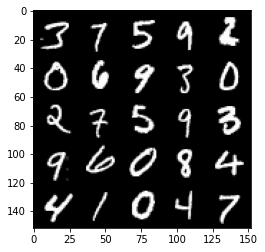

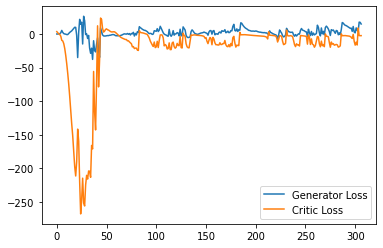

Step 6200: Generator loss: 11.76082769393921, critic loss: -2.776030694007874


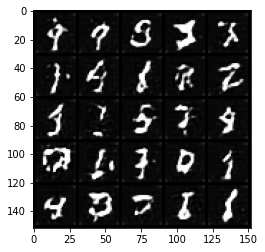

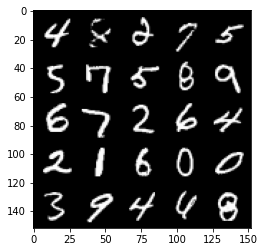

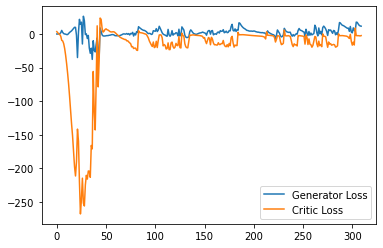

Step 6250: Generator loss: 11.113944835662842, critic loss: -2.6345474801063533


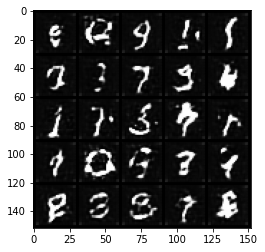

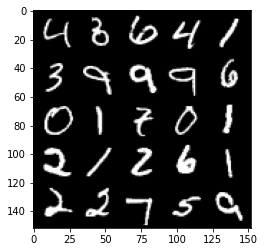

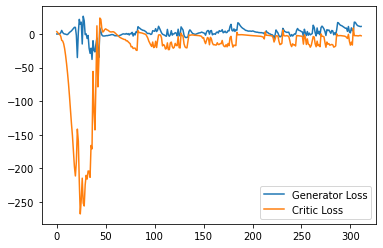

Step 6300: Generator loss: 11.320397605895996, critic loss: -3.1678251867294307


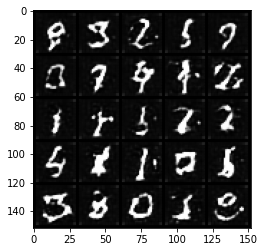

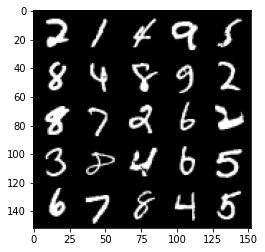

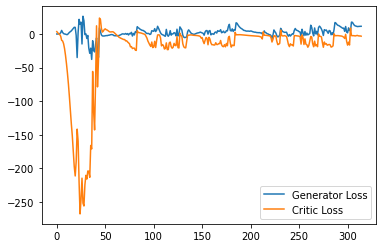

Step 6350: Generator loss: 9.47466007232666, critic loss: -4.5577274684906


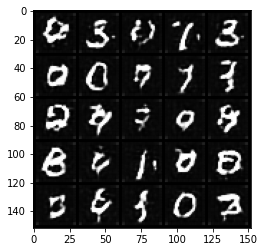

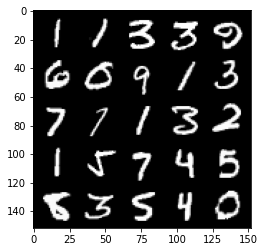

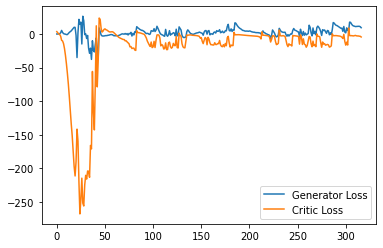

Step 6400: Generator loss: 5.502098250389099, critic loss: -13.740929138898847


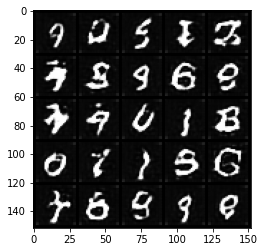

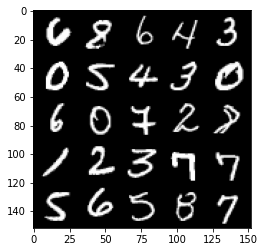

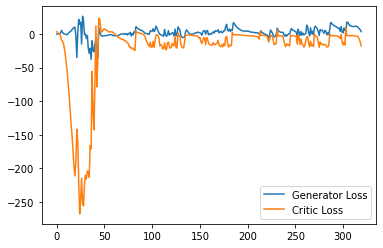

Step 6450: Generator loss: 8.206259822845459, critic loss: -7.910038401126863


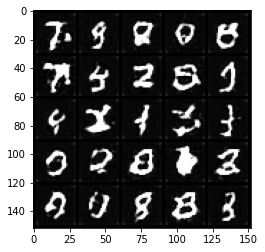

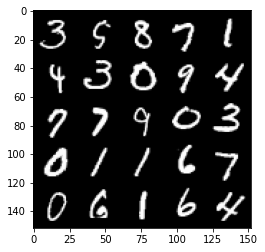

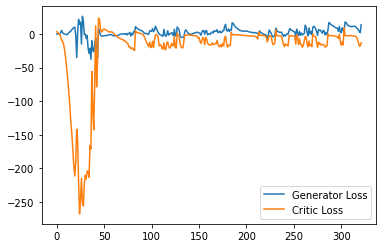

Step 6500: Generator loss: 14.716005554199219, critic loss: -2.761355977535248


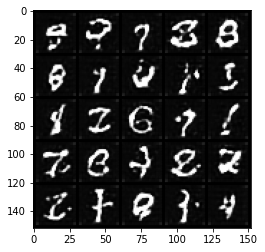

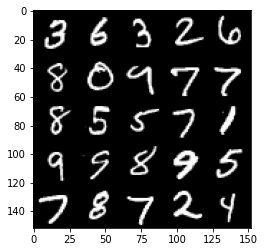

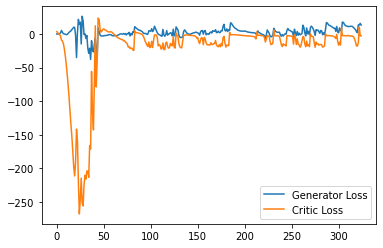

Step 6550: Generator loss: 12.40503828048706, critic loss: -2.862263833522797


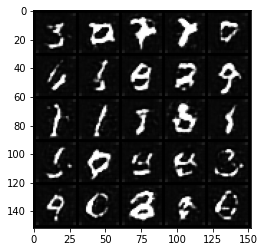

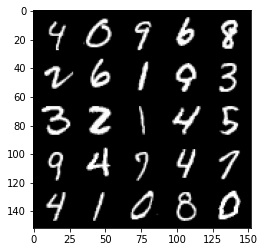

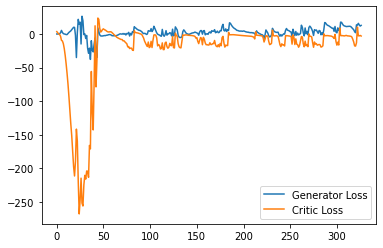

Step 6600: Generator loss: 11.41422097682953, critic loss: -4.842454413890838


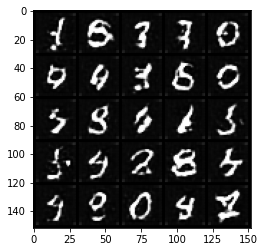

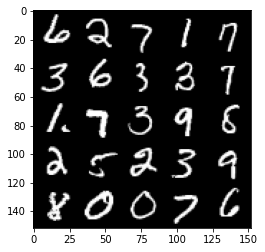

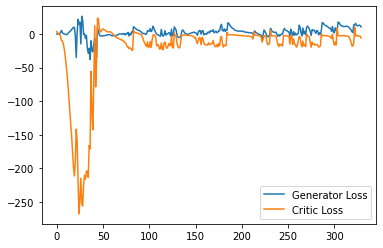

Step 6650: Generator loss: 14.983897676467896, critic loss: -6.994554839611054


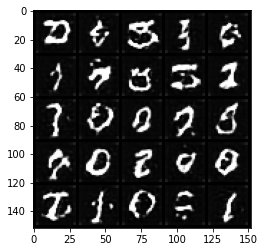

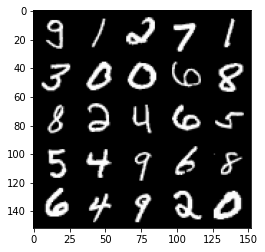

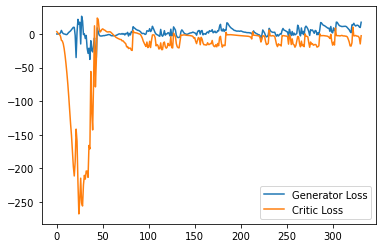

Step 6700: Generator loss: 7.461118450984359, critic loss: -16.735078650951387


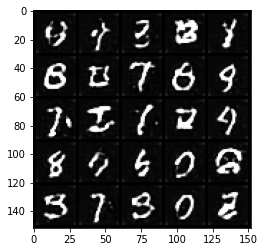

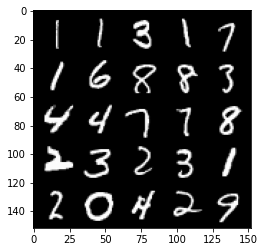

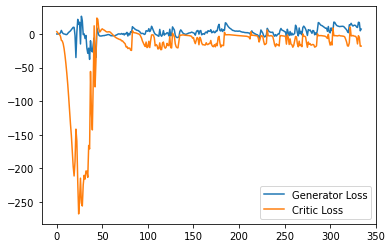

Step 6750: Generator loss: 16.079437991827728, critic loss: -1.480775194168091


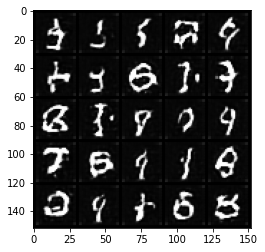

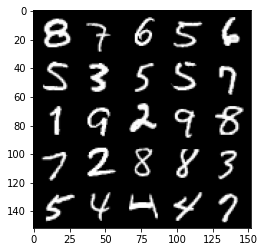

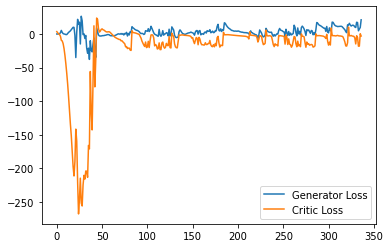

Step 6800: Generator loss: 17.191702213287353, critic loss: -3.419196943759918


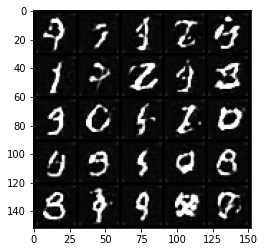

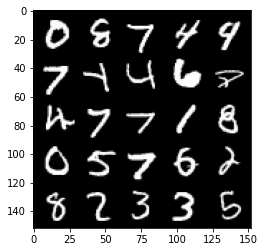

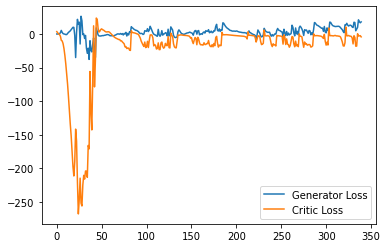

Step 6850: Generator loss: 13.292981610000133, critic loss: -13.28074298667908


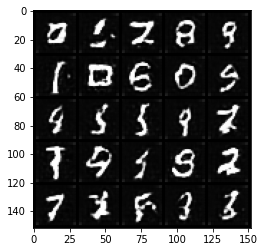

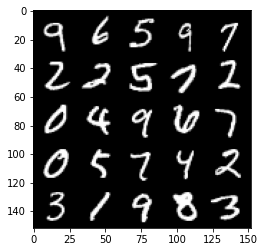

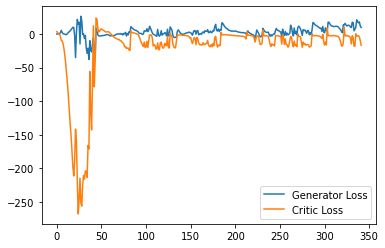

Step 6900: Generator loss: 13.657100703716278, critic loss: -12.797104803562164


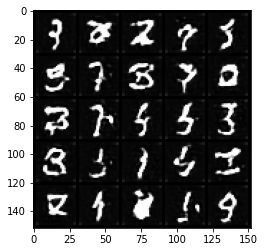

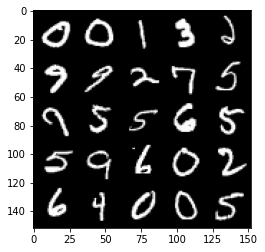

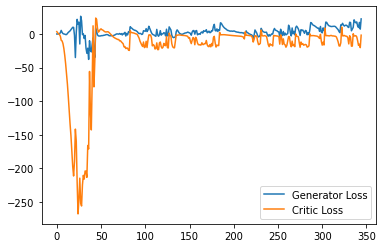

Step 6950: Generator loss: 12.727100582122803, critic loss: -14.493883770942686


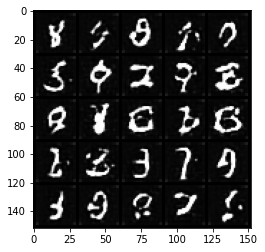

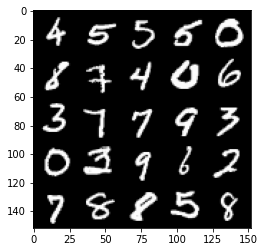

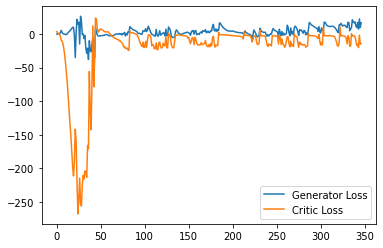

Step 7000: Generator loss: 13.281081848144531, critic loss: -16.64841143321991


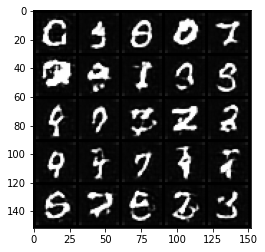

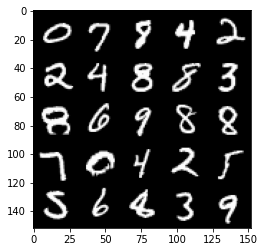

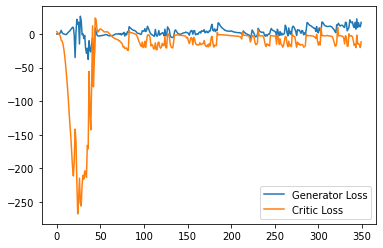

Step 7050: Generator loss: 12.76762374728918, critic loss: -19.76590104293824


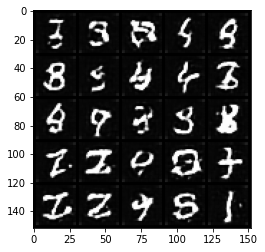

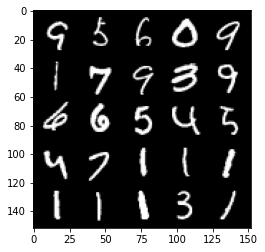

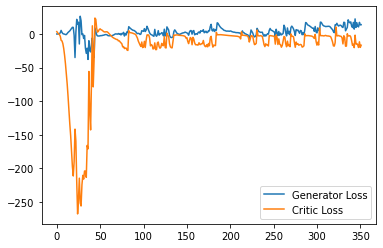

Step 7100: Generator loss: 14.880162534117698, critic loss: -15.36301381134987


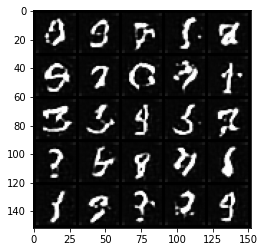

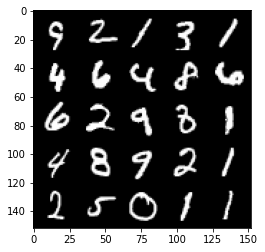

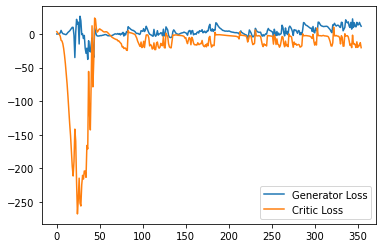

Step 7150: Generator loss: 9.915773340463637, critic loss: -20.62941369485855


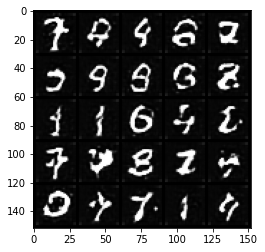

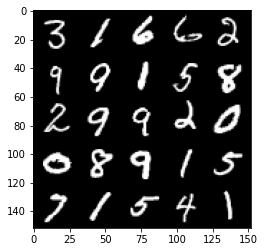

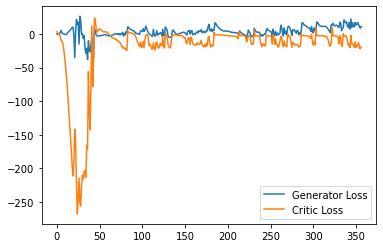

Step 7200: Generator loss: 13.549507357627153, critic loss: -20.812477273464197


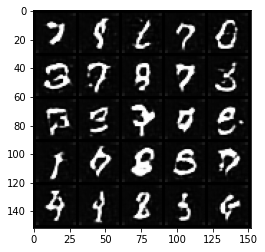

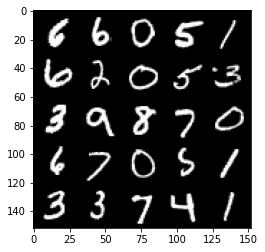

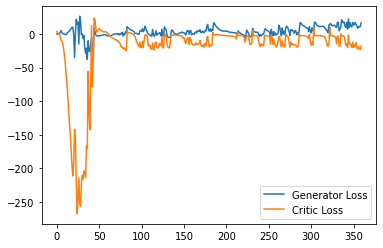

Step 7250: Generator loss: 14.888671369552613, critic loss: -18.984050330400468


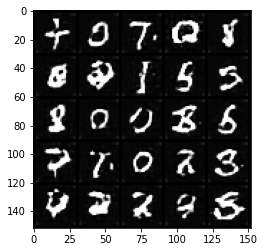

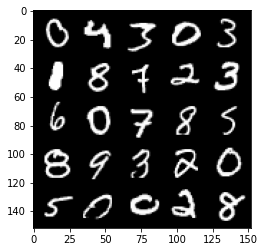

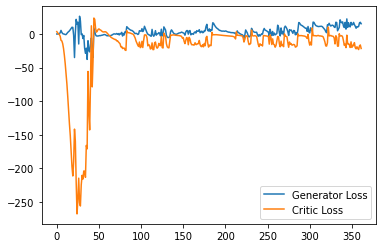

Step 7300: Generator loss: 17.223118522167205, critic loss: -18.81893615460396


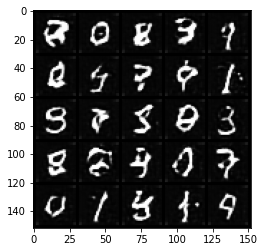

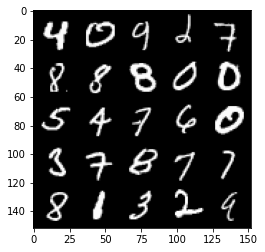

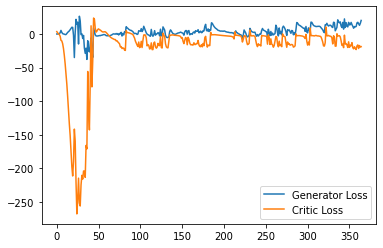

Step 7350: Generator loss: 17.754727563858033, critic loss: -16.965214218616484


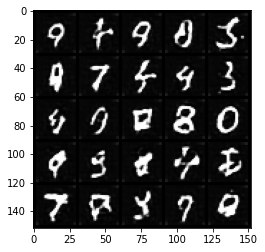

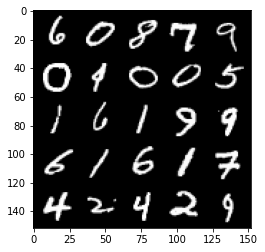

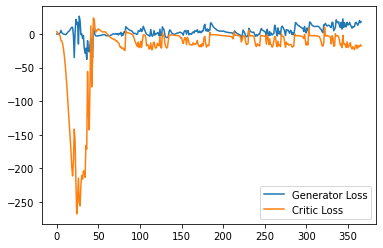

Step 7400: Generator loss: 21.931071457862853, critic loss: -4.510541123867034


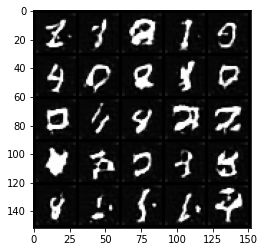

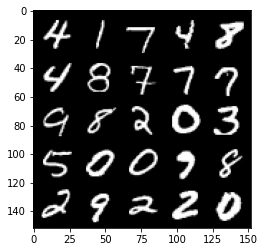

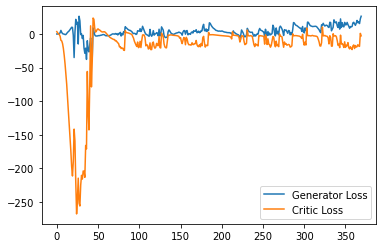

Step 7450: Generator loss: 20.26296999812126, critic loss: -6.553993764877318


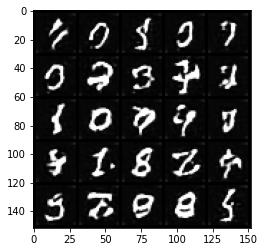

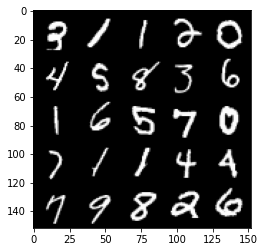

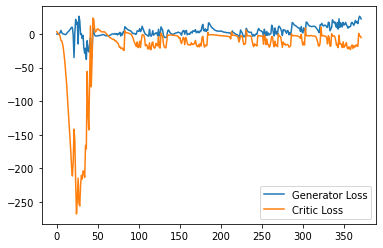

Step 7500: Generator loss: 18.029530730247497, critic loss: -13.097207859754565


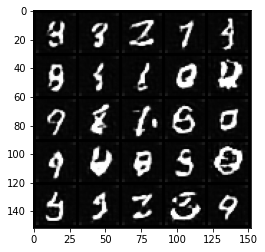

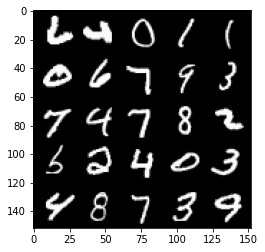

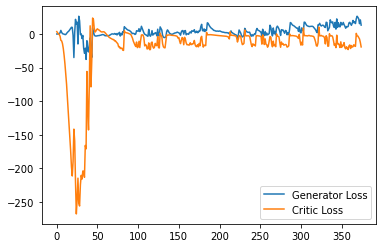

Step 7550: Generator loss: 16.7019761800766, critic loss: -17.654247143745422


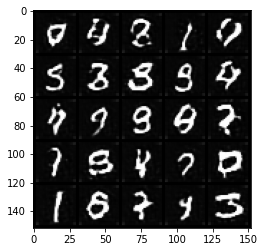

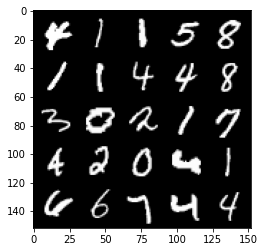

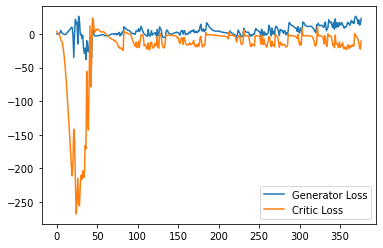

Step 7600: Generator loss: 18.382653935849667, critic loss: -19.156309928178793


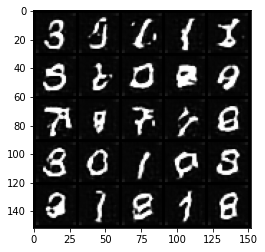

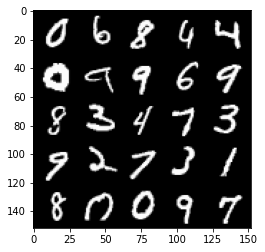

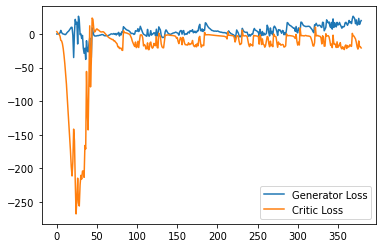

Step 7650: Generator loss: 24.67961968421936, critic loss: -11.058932320594785


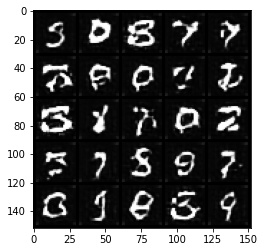

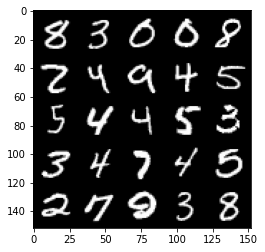

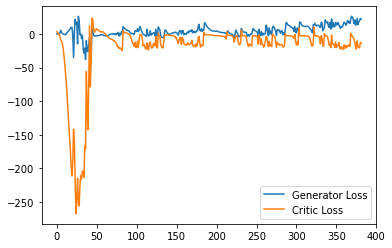

Step 7700: Generator loss: 22.156109428405763, critic loss: -15.762090022802356


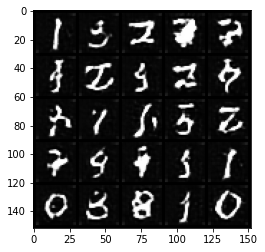

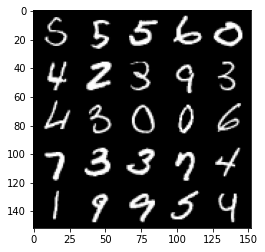

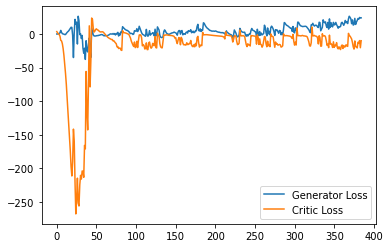

Step 7750: Generator loss: 20.22773123383522, critic loss: -15.091312109470369


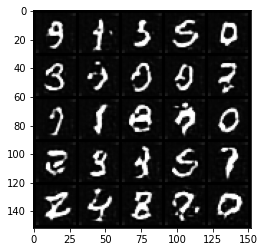

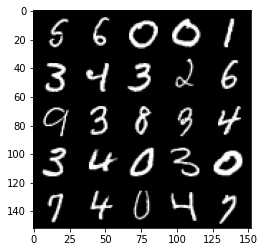

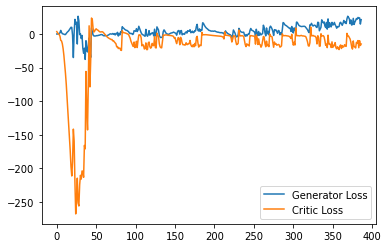

Step 7800: Generator loss: 26.54424955368042, critic loss: 0.9013690571784982


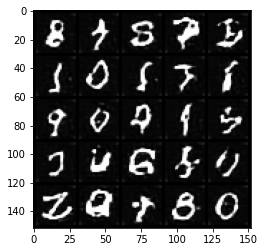

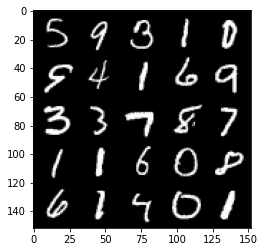

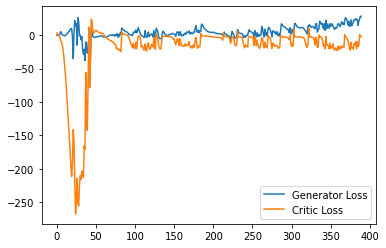

Step 7850: Generator loss: 25.894031982421875, critic loss: -4.0172566928863525


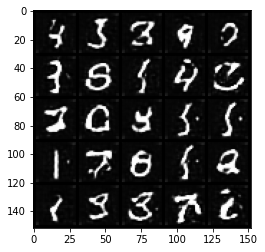

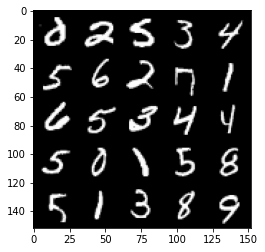

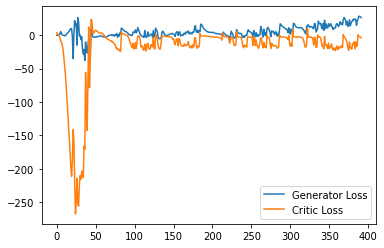

Step 7900: Generator loss: 20.965998892784118, critic loss: -15.825943553924565


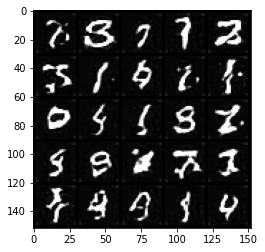

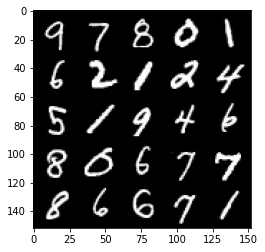

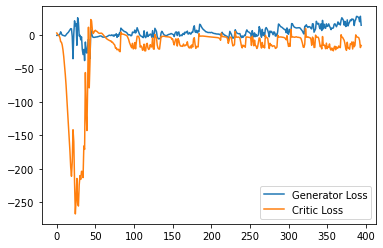

Step 7950: Generator loss: 22.89345672607422, critic loss: -14.472154932498933


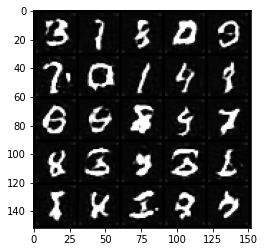

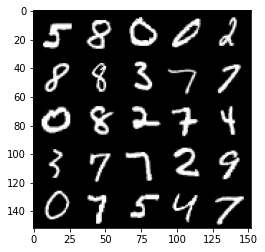

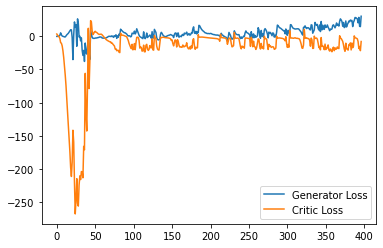

Step 8000: Generator loss: 18.84895031929016, critic loss: -18.0057594666481


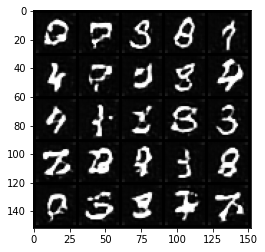

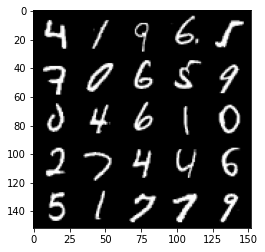

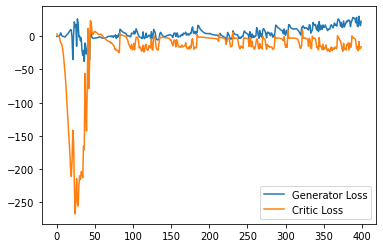

Step 8050: Generator loss: 18.014295495152474, critic loss: -20.373075356960292


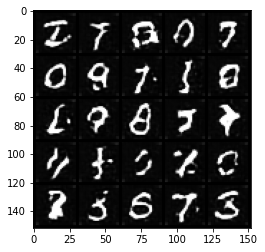

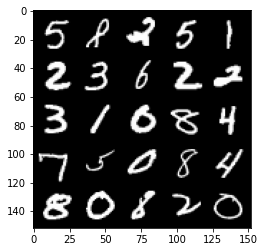

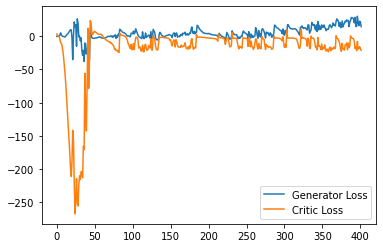

Step 8100: Generator loss: 20.485487422943116, critic loss: -16.81839125823975


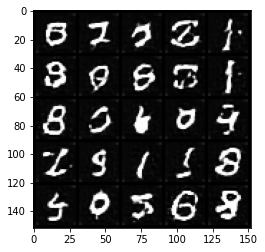

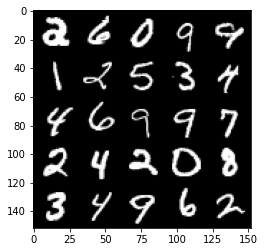

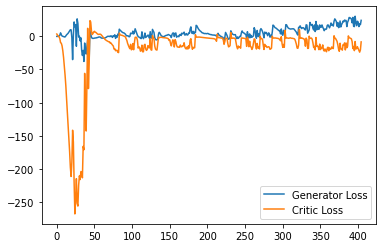

Step 8150: Generator loss: 27.65328342437744, critic loss: -13.45519337034225


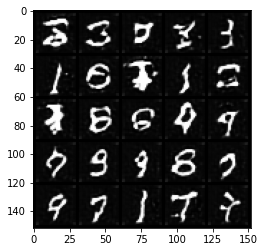

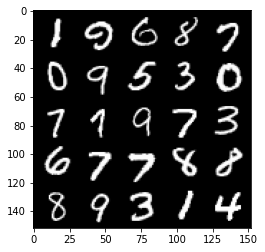

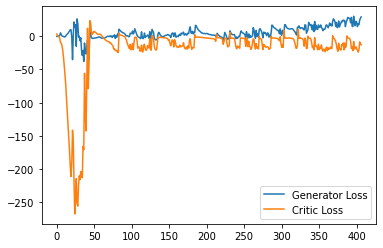

Step 8200: Generator loss: 23.89063970565796, critic loss: -12.599855638980863


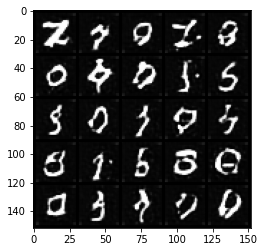

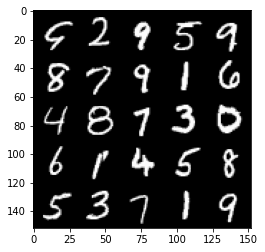

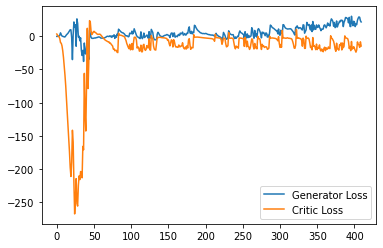

Step 8250: Generator loss: 16.614264924526214, critic loss: -19.96334659481049


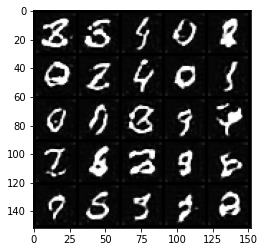

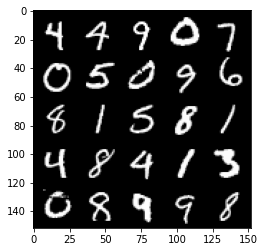

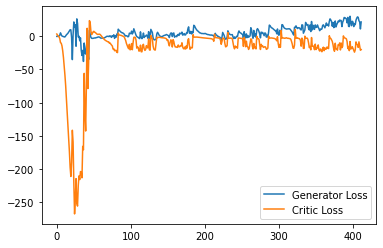

Step 8300: Generator loss: 19.25594165802002, critic loss: -20.577707314968112


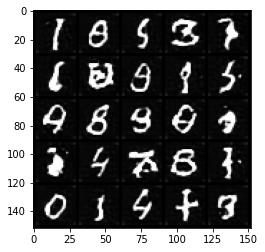

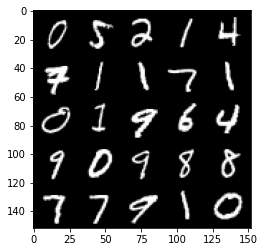

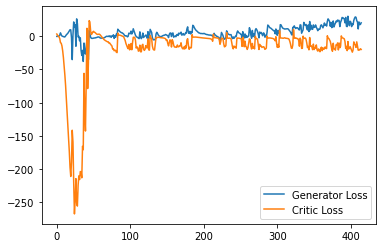

Step 8350: Generator loss: 19.501336476802827, critic loss: -13.370004345417021


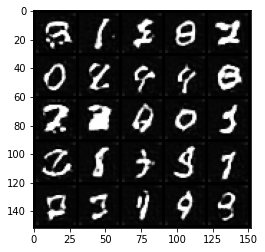

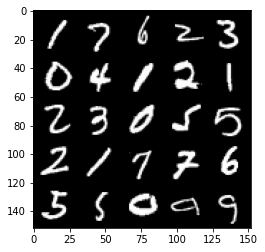

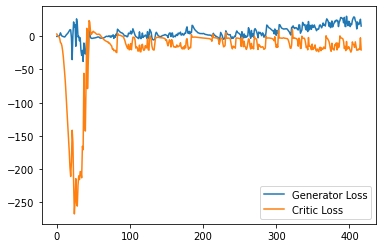

Step 8400: Generator loss: 21.684631290435792, critic loss: -20.193385434627533


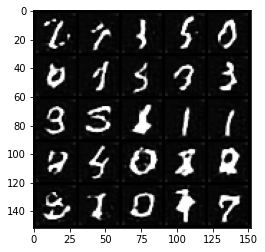

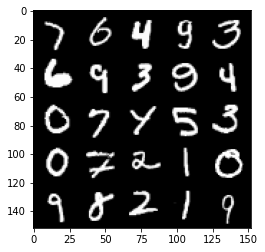

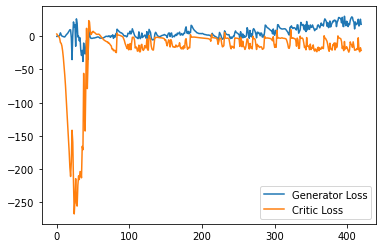

Step 8450: Generator loss: 22.23343876838684, critic loss: -20.671094765186307


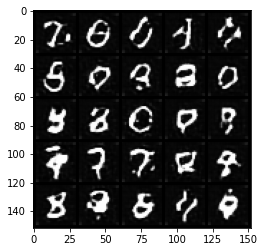

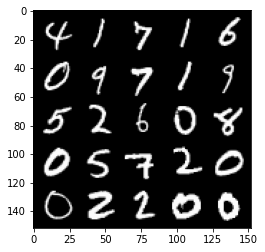

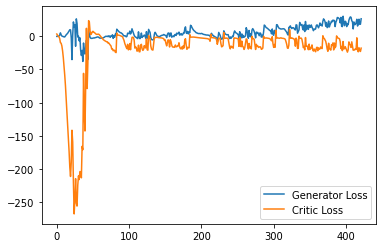

Step 8500: Generator loss: 20.50246120452881, critic loss: -20.573155967712406


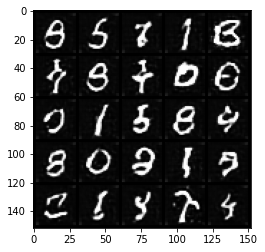

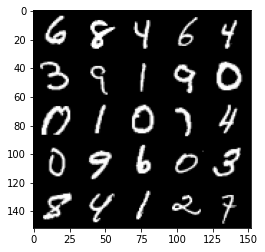

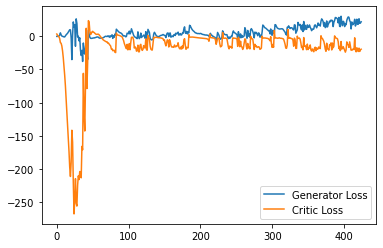

Step 8550: Generator loss: 23.431442403793334, critic loss: -18.58456452655792


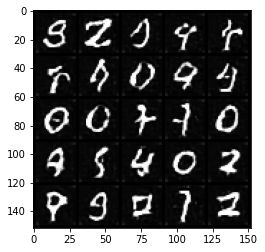

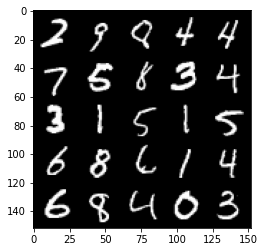

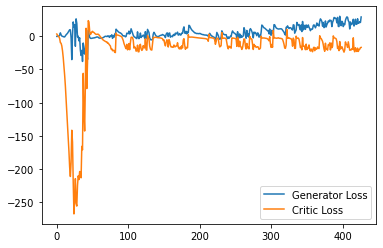

Step 8600: Generator loss: 28.17333917617798, critic loss: -16.104504516601565


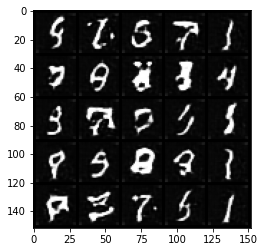

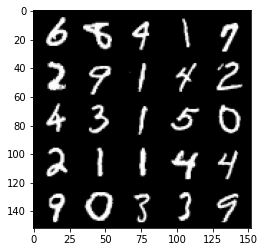

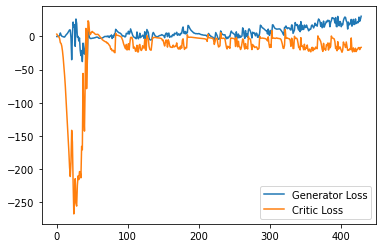

Step 8650: Generator loss: 22.237733635902405, critic loss: -19.397535018682483


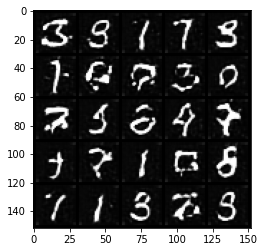

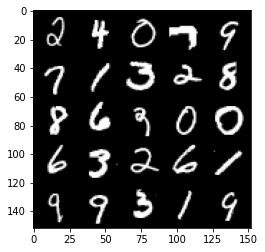

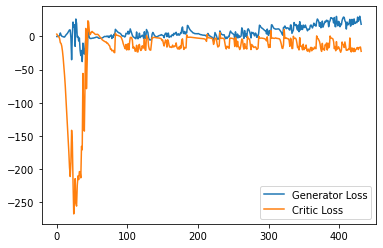

Step 8700: Generator loss: 27.023605461120606, critic loss: -19.64813861465454


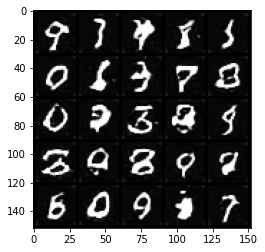

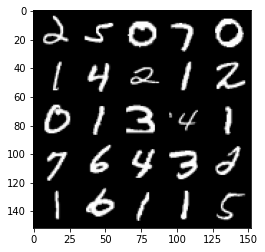

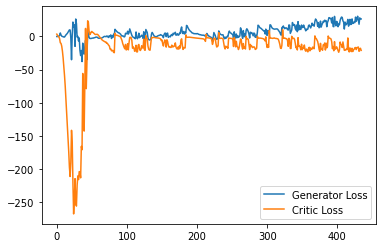

Step 8750: Generator loss: 30.867954449653624, critic loss: -8.996906242370612


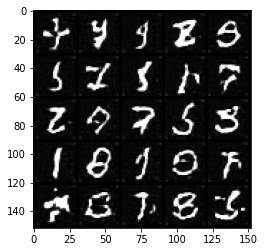

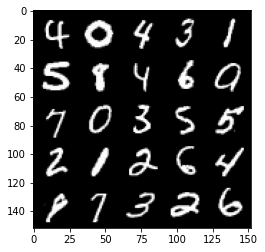

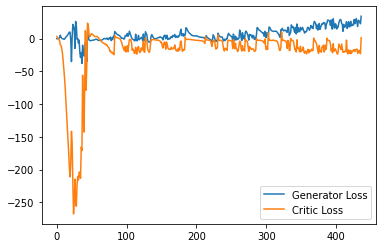

Step 8800: Generator loss: 29.555125694274903, critic loss: -11.794370677947995


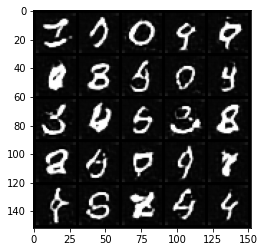

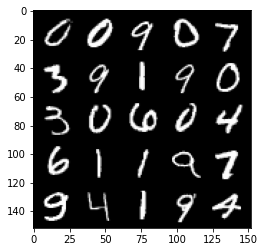

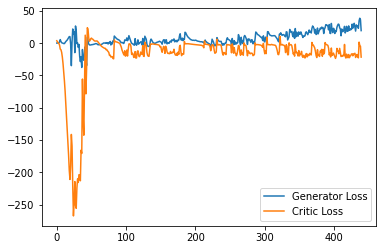

Step 8850: Generator loss: 21.64652811050415, critic loss: -24.21287127828597


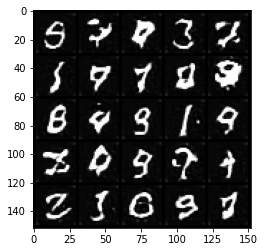

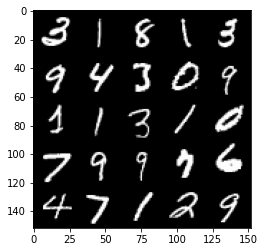

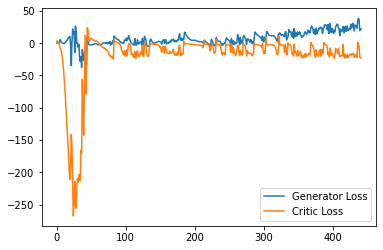

Step 8900: Generator loss: 31.542373218536376, critic loss: -15.29725008058548


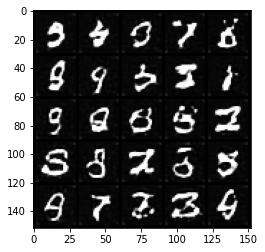

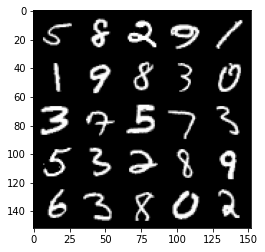

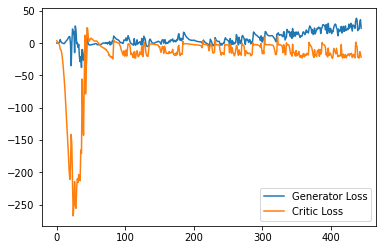

Step 8950: Generator loss: 40.930129280090334, critic loss: -14.864770095348355


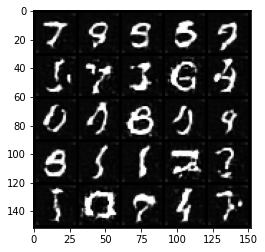

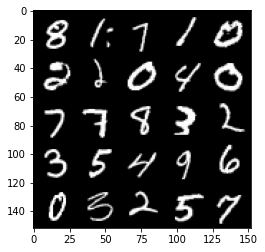

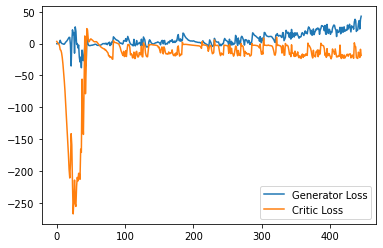

Step 9000: Generator loss: 28.528085145950318, critic loss: -14.048486026763921


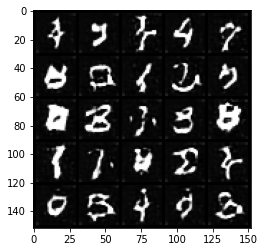

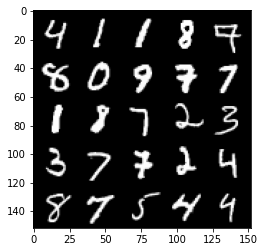

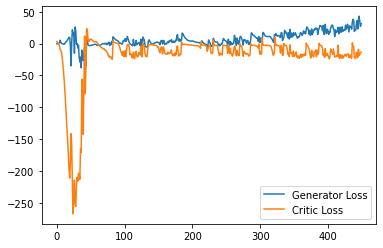

Step 9050: Generator loss: 24.397019414901735, critic loss: -15.557102852344512


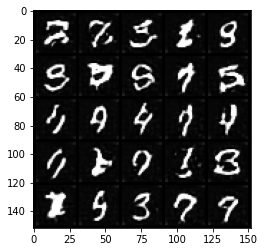

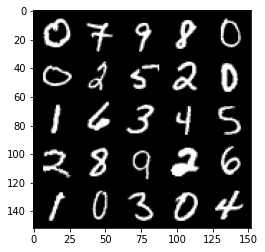

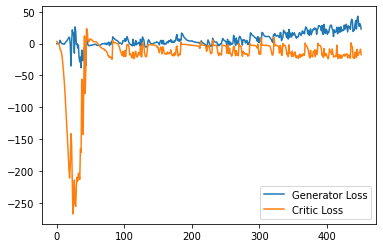

Step 9100: Generator loss: 30.75237928390503, critic loss: -14.915508994579318


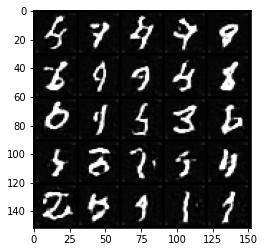

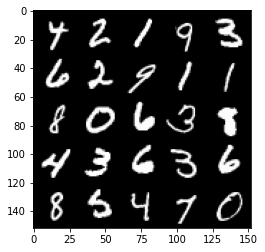

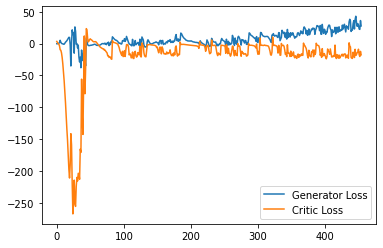

Step 9150: Generator loss: 34.58520336151123, critic loss: -11.915039534568786


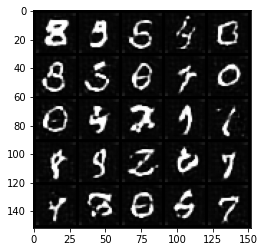

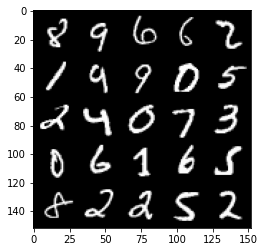

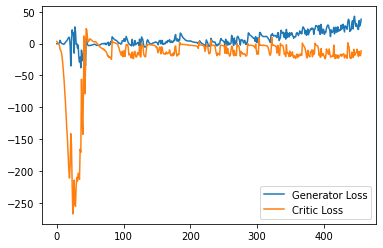

Step 9200: Generator loss: 36.03671859741211, critic loss: -15.89256931900978


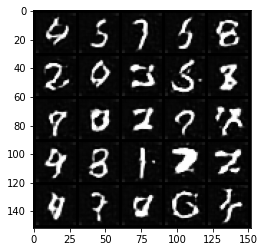

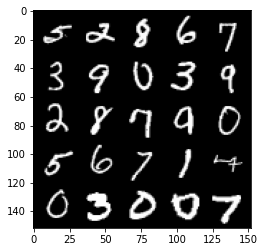

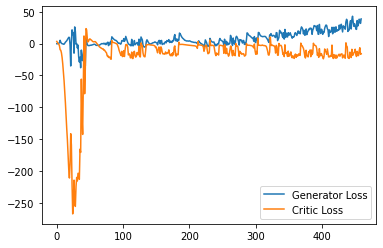

Step 9250: Generator loss: 34.27867977142334, critic loss: -15.81448714494705


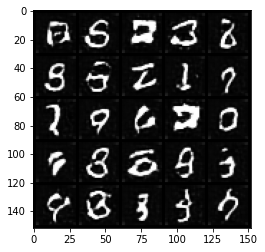

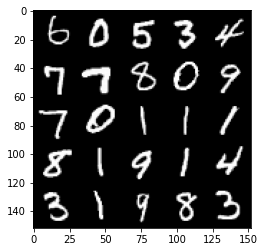

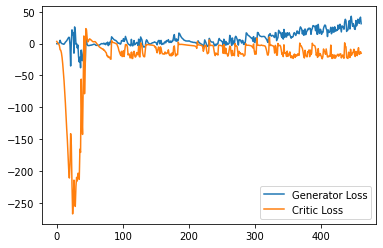

Step 9300: Generator loss: 37.316575031280514, critic loss: -15.299964648962021


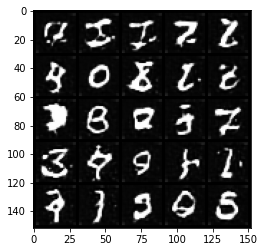

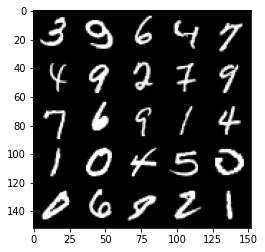

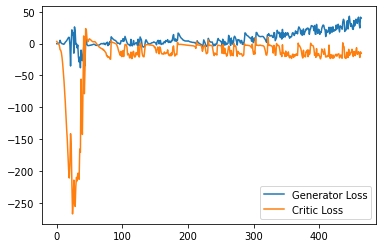

Step 9350: Generator loss: 29.628484926223756, critic loss: -10.570831099033358


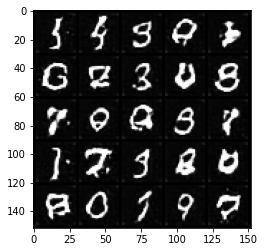

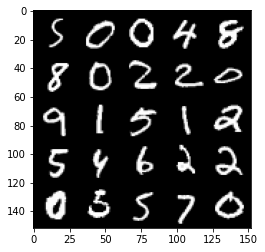

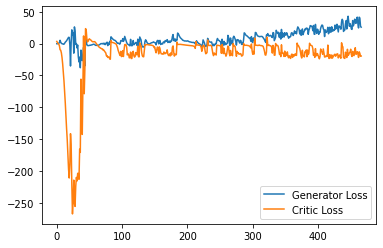

Step 9400: Generator loss: 36.746363487243656, critic loss: -7.671208410263063


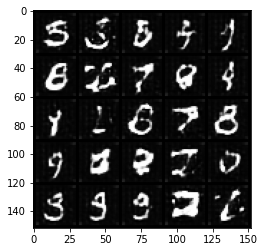

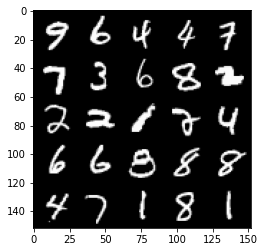

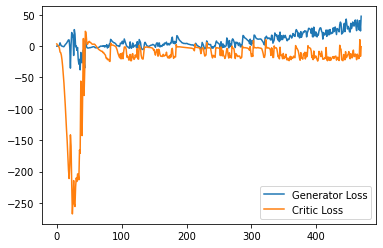

Step 9450: Generator loss: 32.0401131439209, critic loss: -10.77565171098709


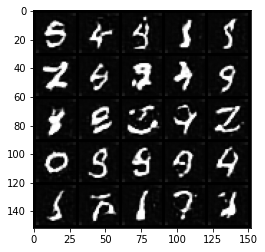

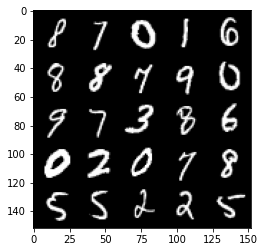

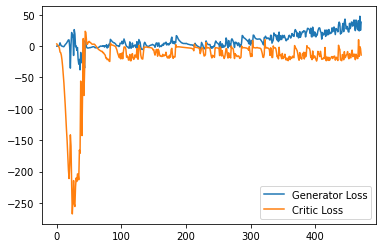

Step 9500: Generator loss: 40.861258544921874, critic loss: -15.350117405414576


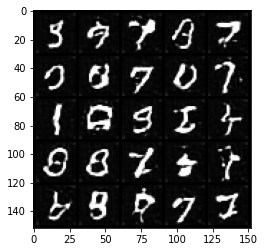

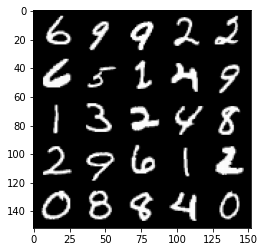

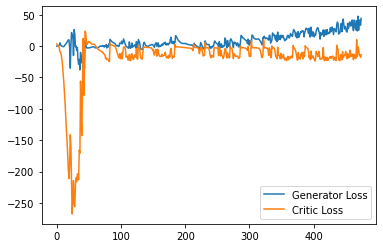

Step 9550: Generator loss: 29.830554809570312, critic loss: -16.45766723966599


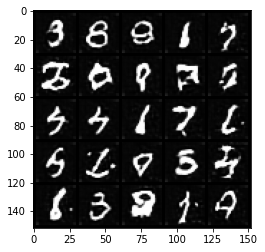

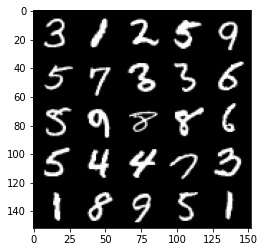

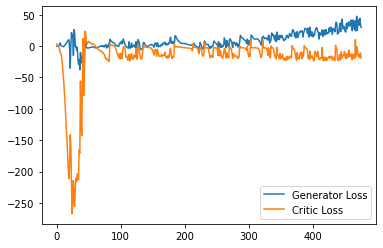

Step 9600: Generator loss: 38.986725616455075, critic loss: -17.319608302116396


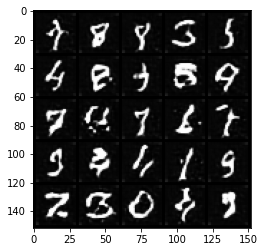

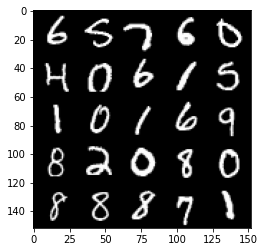

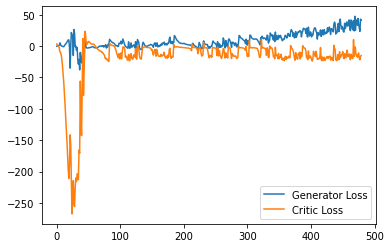

Step 9650: Generator loss: 35.00784219741821, critic loss: -19.235434544086456


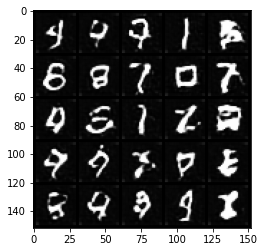

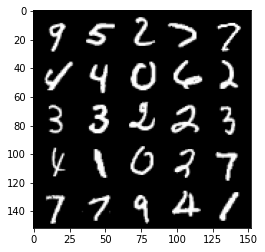

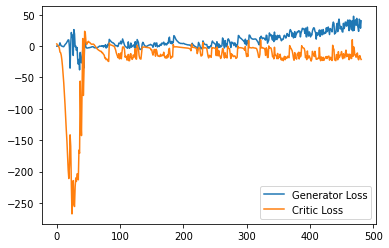

Step 9700: Generator loss: 39.10077335357666, critic loss: -3.2677173709869374


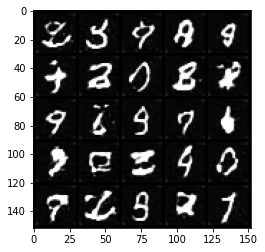

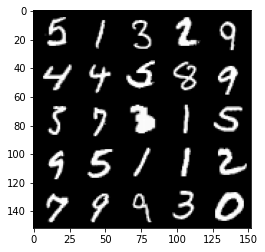

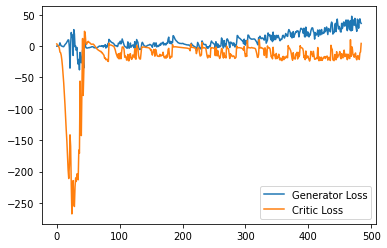

Step 9750: Generator loss: 36.062036476135255, critic loss: -12.545210679292682


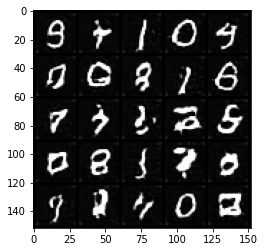

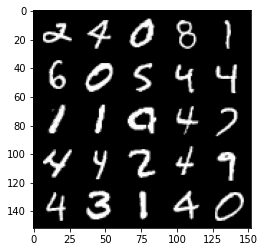

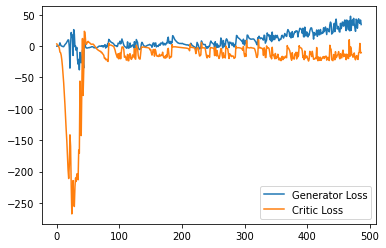

Step 9800: Generator loss: 43.26752775192261, critic loss: -10.267644054889683


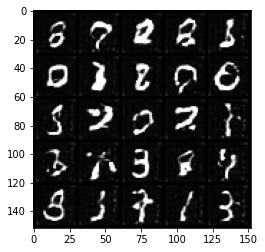

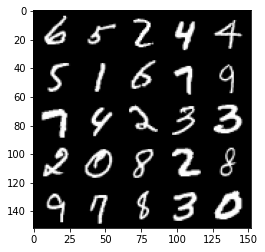

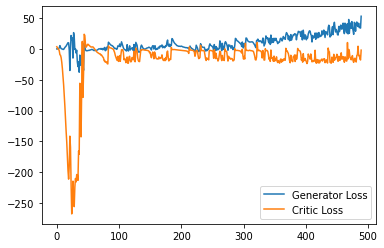

Step 9850: Generator loss: 30.386877956390382, critic loss: -16.669017780303957


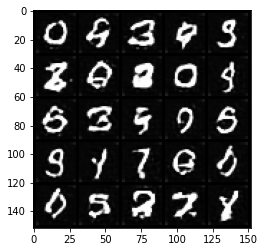

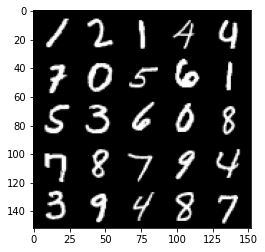

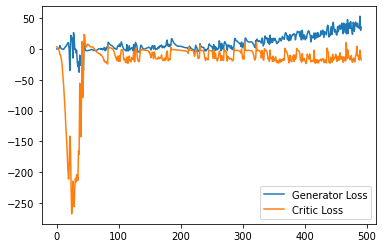

Step 9900: Generator loss: 31.813851747512818, critic loss: -19.611323714256287


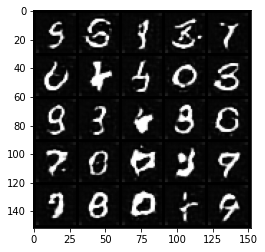

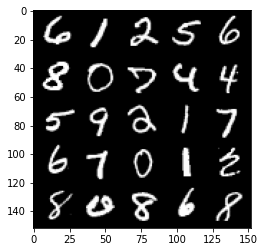

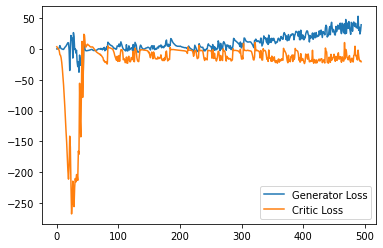

Step 9950: Generator loss: 39.33217458724975, critic loss: -0.23791879343986416


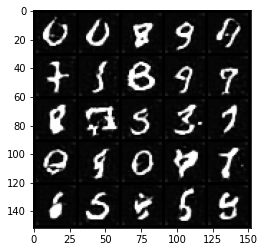

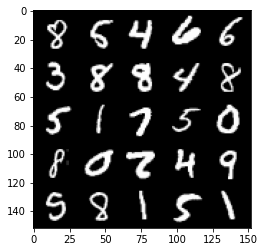

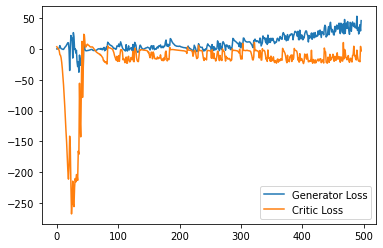

Step 10000: Generator loss: 32.10307209014893, critic loss: -15.03070404243469


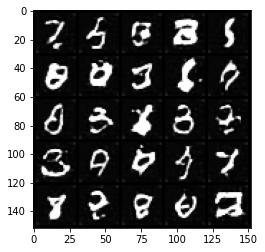

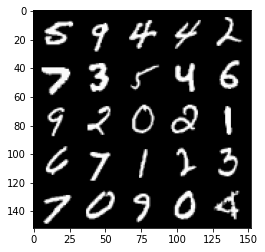

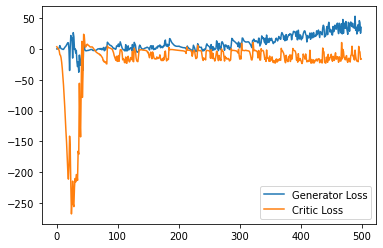

Step 10050: Generator loss: 35.88523586273193, critic loss: -17.657473876714707


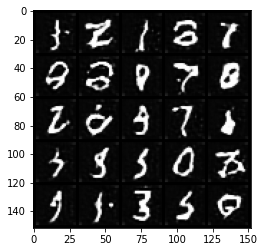

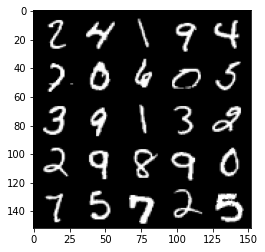

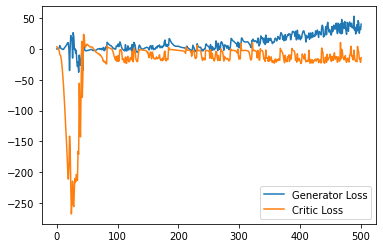

Step 10100: Generator loss: 44.909951820373536, critic loss: -12.166596261501311


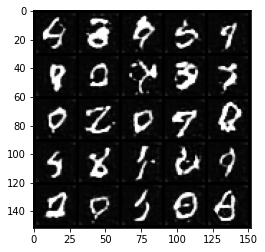

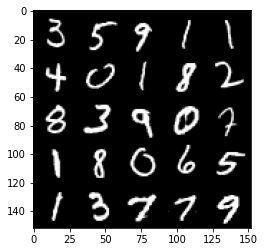

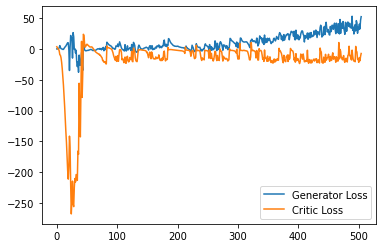

Step 10150: Generator loss: 36.8132445526123, critic loss: -13.846106704711918


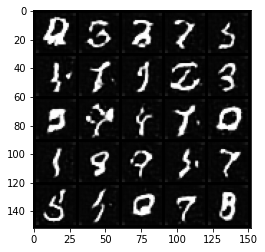

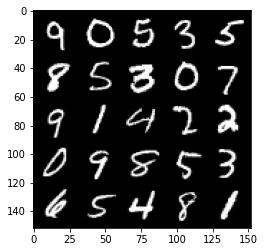

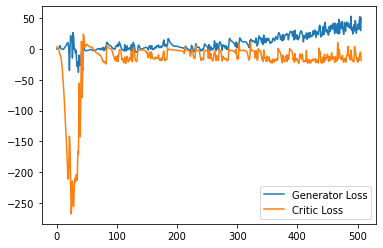

Step 10200: Generator loss: 29.793792552948, critic loss: -19.72879166436196


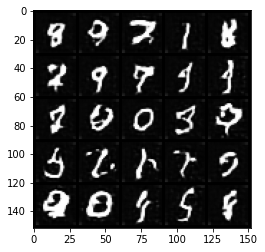

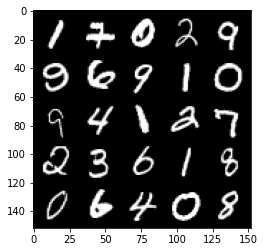

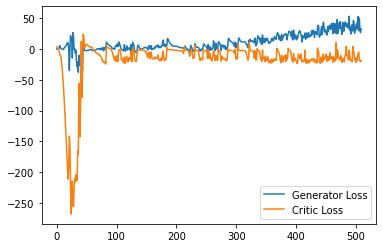

Step 10250: Generator loss: 37.22188352584839, critic loss: -19.50312735414505


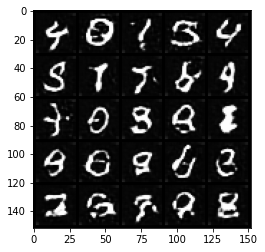

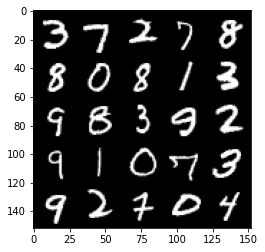

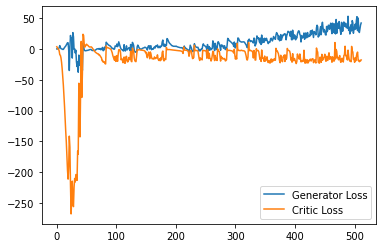

Step 10300: Generator loss: 29.953096399307253, critic loss: -21.18582490849495


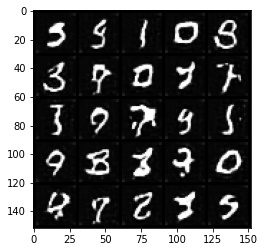

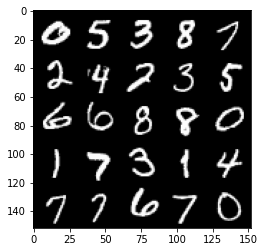

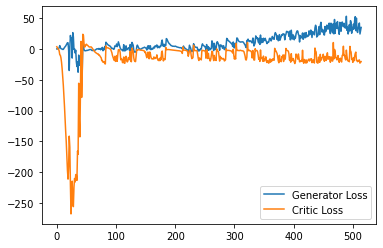

Step 10350: Generator loss: 44.02021503448486, critic loss: -10.419569622039791


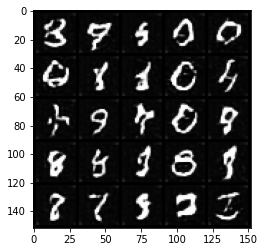

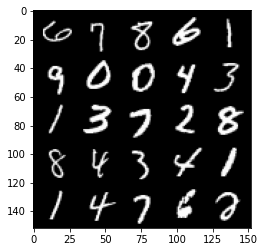

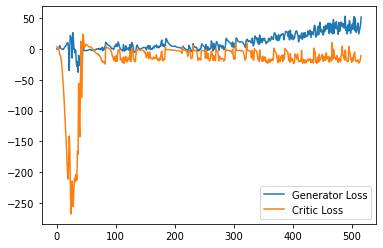

Step 10400: Generator loss: 37.96390090942383, critic loss: -16.176565473794938


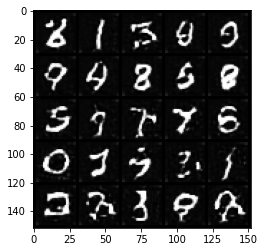

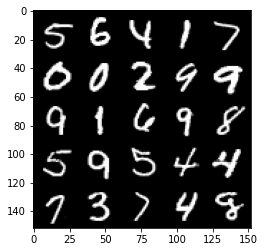

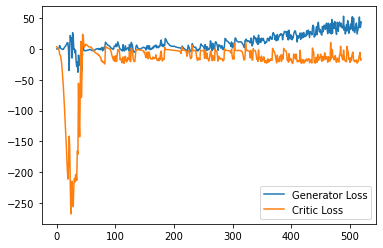

Step 10450: Generator loss: 40.56845443725586, critic loss: -18.6595269742012


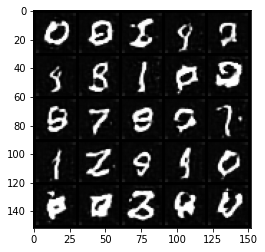

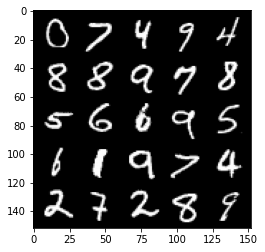

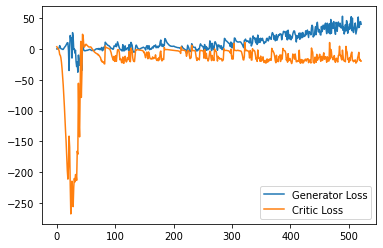

Step 10500: Generator loss: 35.33001323699951, critic loss: -21.797891020059588


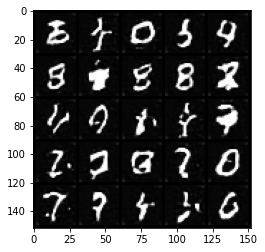

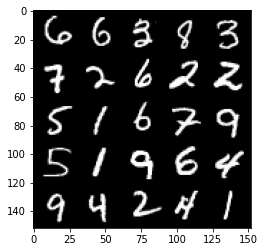

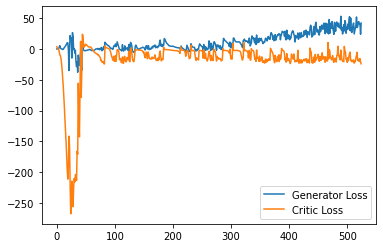

Step 10550: Generator loss: 42.82609619140625, critic loss: 3.247646959304809


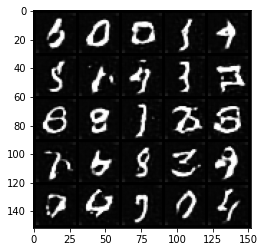

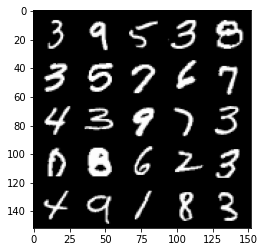

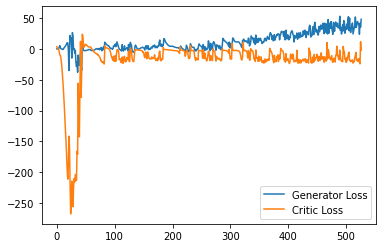

Step 10600: Generator loss: 44.96119400024414, critic loss: -3.561126158714294


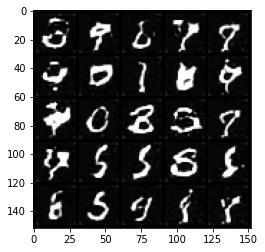

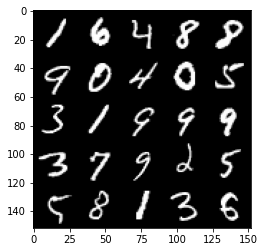

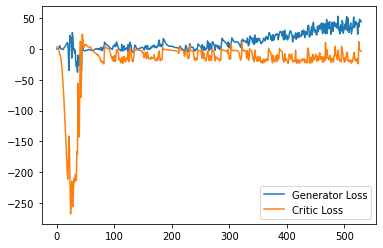

Step 10650: Generator loss: 33.49995170593262, critic loss: -13.438742953777313


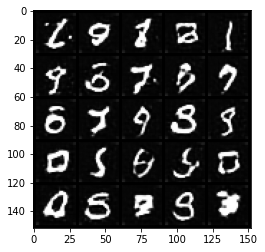

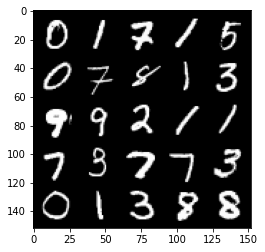

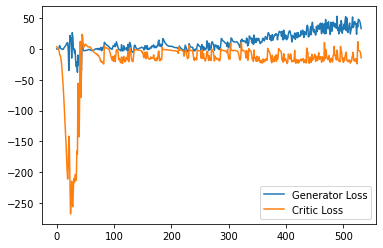

Step 10700: Generator loss: 41.64054365158081, critic loss: -20.968549805641175


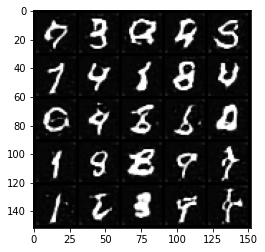

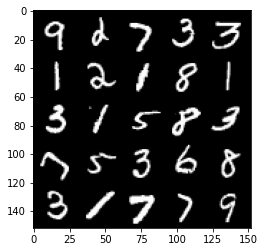

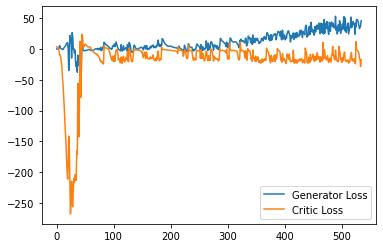

Step 10750: Generator loss: 44.01411891937256, critic loss: -16.528090881109236


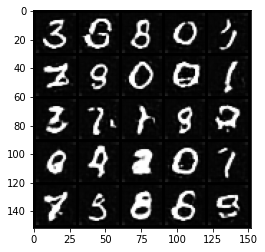

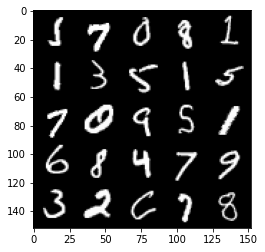

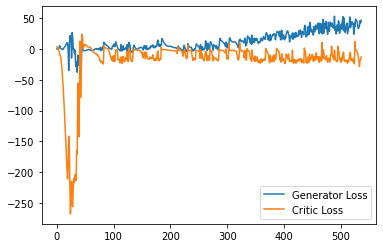

Step 10800: Generator loss: 43.222961835861206, critic loss: -15.495502363681796


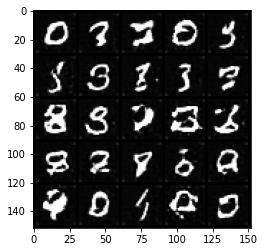

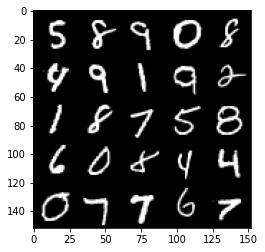

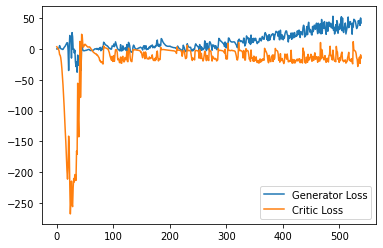

Step 10850: Generator loss: 39.668133926391604, critic loss: -11.245723798513408


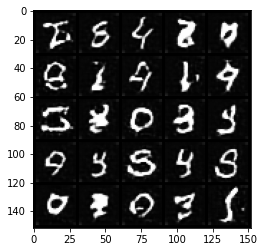

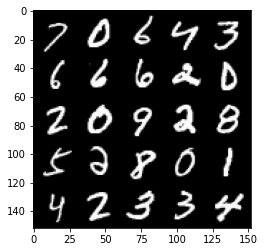

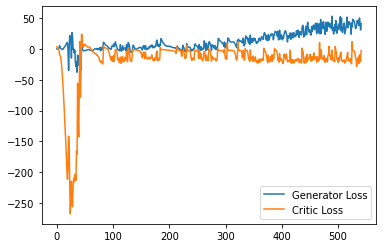

Step 10900: Generator loss: 45.3576123046875, critic loss: -16.825717021942136


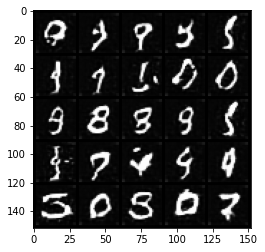

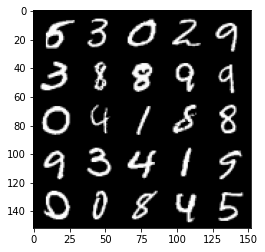

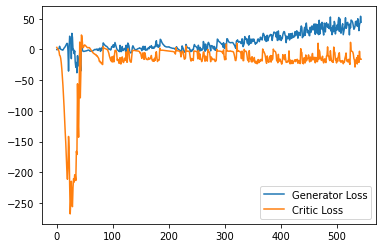

Step 10950: Generator loss: 40.323393745422365, critic loss: -16.073839730024332


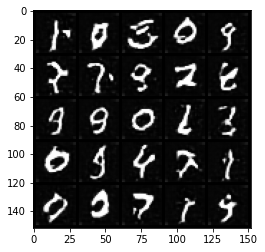

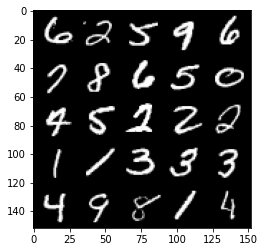

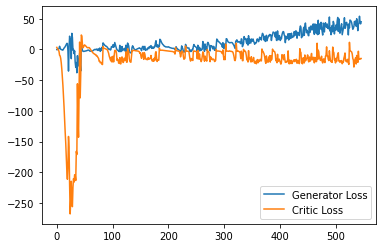

Step 11000: Generator loss: 35.97272819519043, critic loss: -19.976847897529602


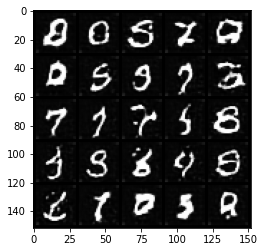

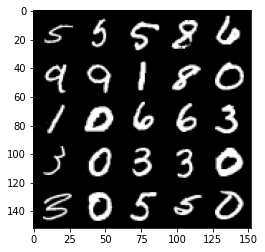

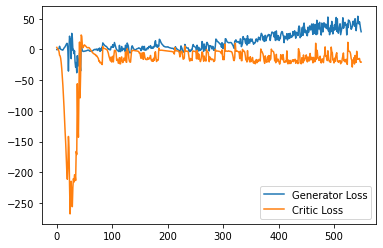

Step 11050: Generator loss: 44.146402778625486, critic loss: -17.251584299564364


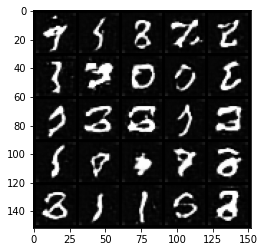

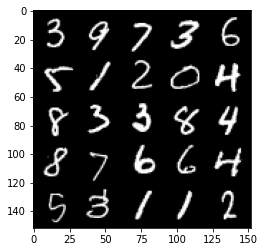

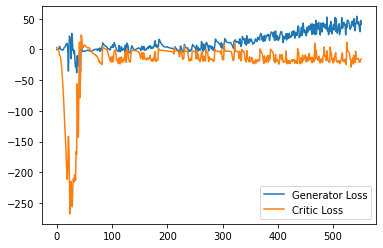

Step 11100: Generator loss: 37.49839322090149, critic loss: -18.896200579643256


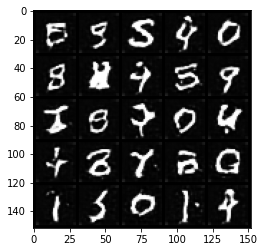

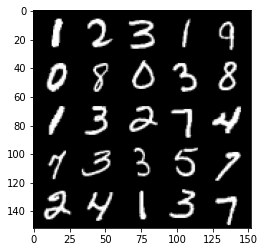

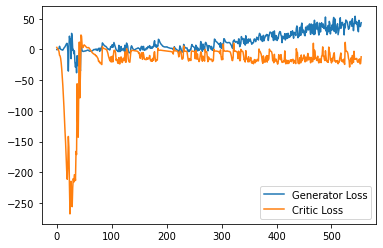

Step 11150: Generator loss: 33.219460525512694, critic loss: -19.75223146772385


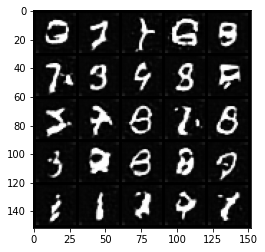

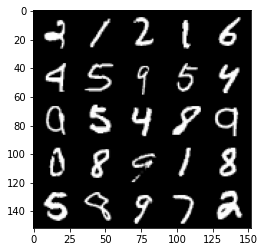

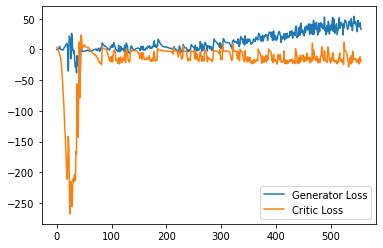

Step 11200: Generator loss: 38.53201417922973, critic loss: -27.348246229171753


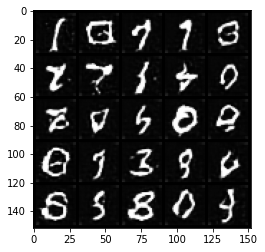

Step 12250: Generator loss: 45.92085870742798, critic loss: -19.281316553115843


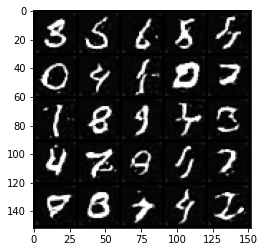

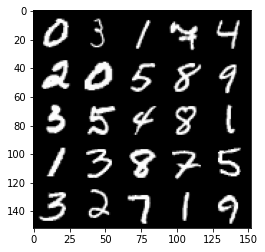

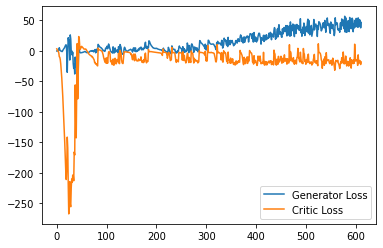

Step 12300: Generator loss: 45.54950950622558, critic loss: -17.04839433860779


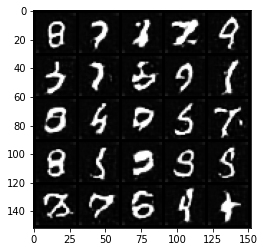

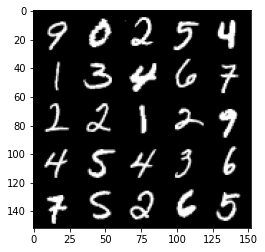

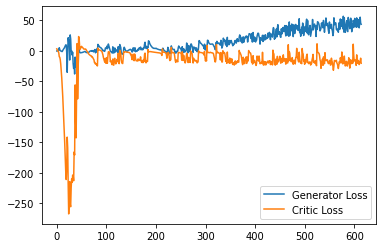

Step 12350: Generator loss: 43.64441204071045, critic loss: -17.46132552075386


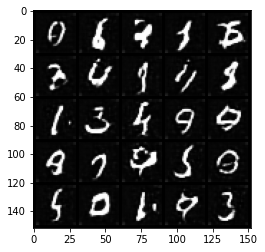

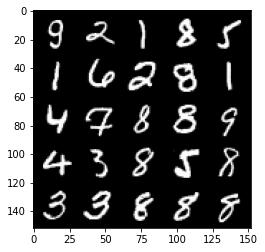

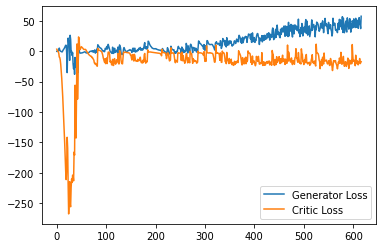

Step 12400: Generator loss: 51.29976612091065, critic loss: -8.502520628094672


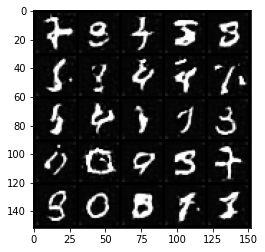

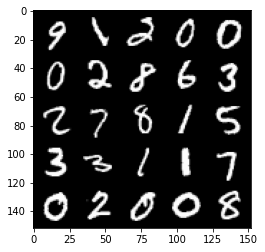

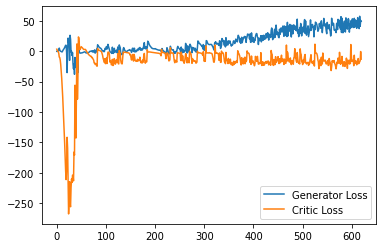

Step 12450: Generator loss: 39.361897487640384, critic loss: -21.33654923534393


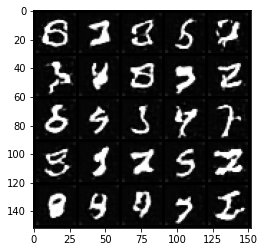

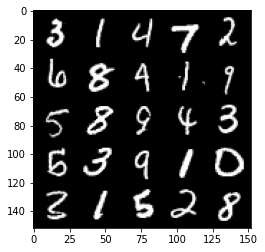

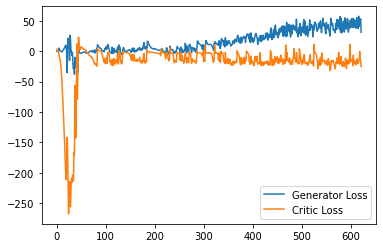

Step 12500: Generator loss: 43.11601266860962, critic loss: -23.698939469337464


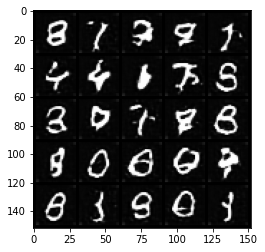

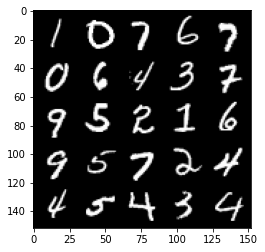

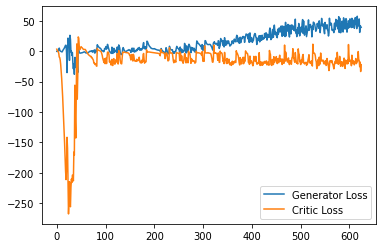

Step 12550: Generator loss: 50.31938327789307, critic loss: -20.507802666664116


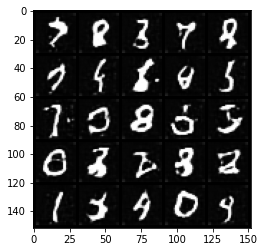

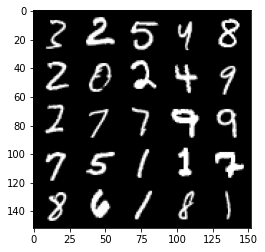

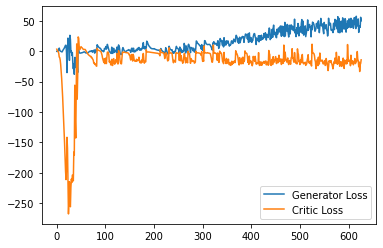

Step 12600: Generator loss: 44.141738634109494, critic loss: -13.114494637489317


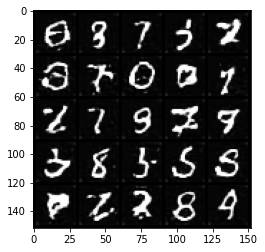

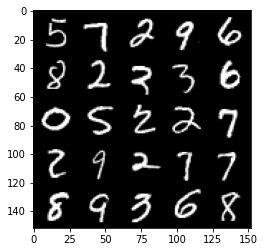

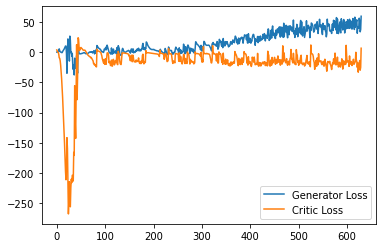

Step 12650: Generator loss: 35.161717587709425, critic loss: -23.1985887746811


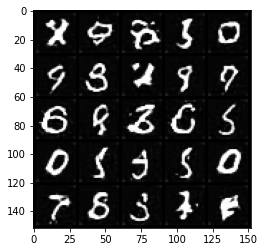

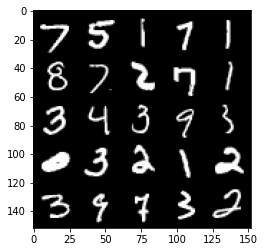

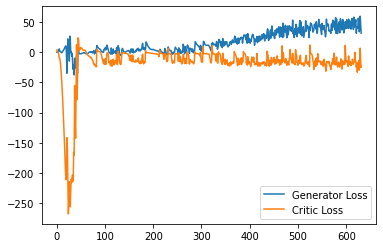

Step 12700: Generator loss: 51.93771409988403, critic loss: -16.646020497322084


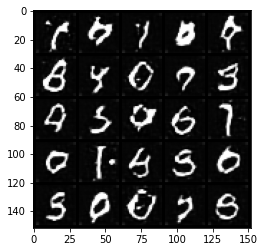

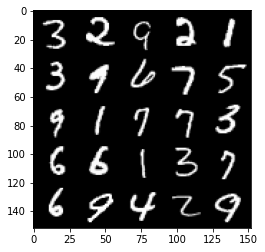

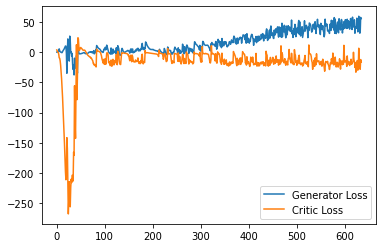

Step 12750: Generator loss: 47.66935600280762, critic loss: -16.654326756477356


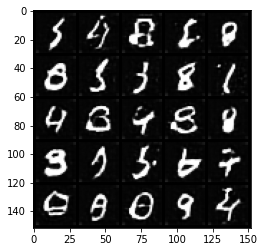

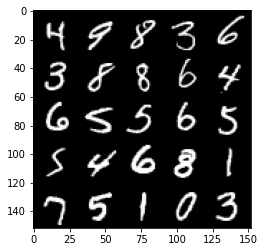

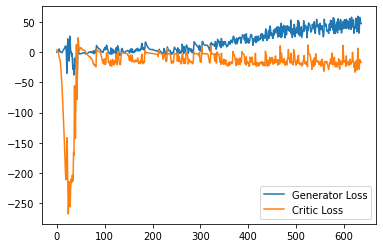

Step 12800: Generator loss: 39.67086803674698, critic loss: -11.171805898189543


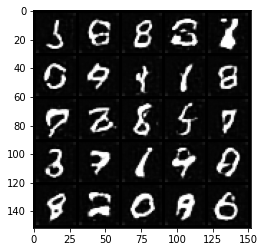

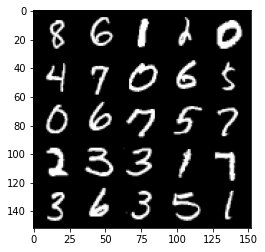

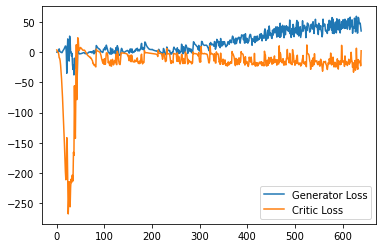

Step 12850: Generator loss: 51.96066150665283, critic loss: -5.8458777885437


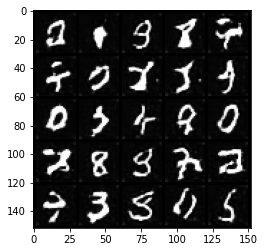

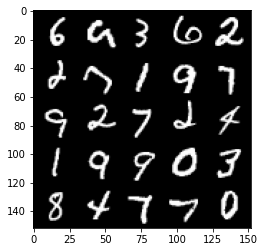

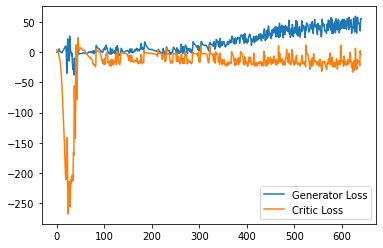

Step 12900: Generator loss: 50.020690784454345, critic loss: -15.245312739372254


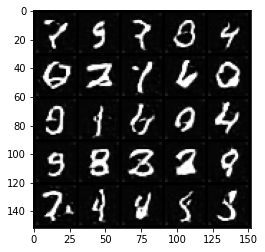

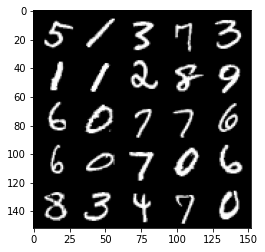

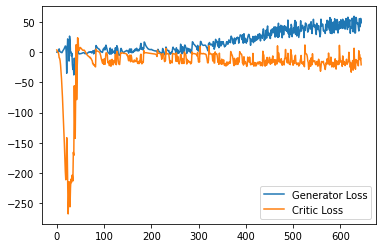

Step 12950: Generator loss: 37.575453758239746, critic loss: -21.9592205080986


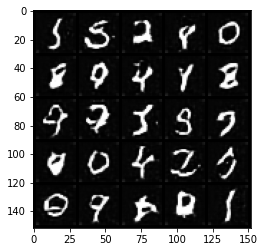

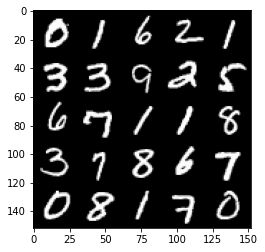

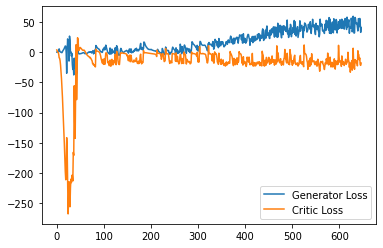

Step 13000: Generator loss: 43.990963783264164, critic loss: -22.129564394950865


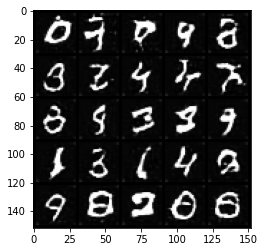

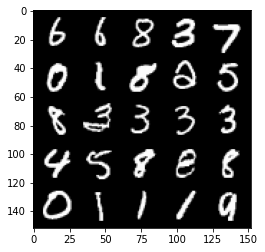

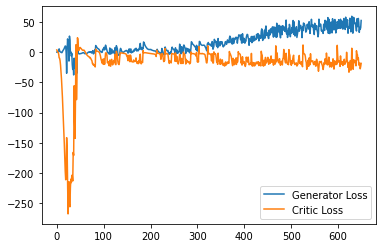

Step 13050: Generator loss: 51.20587158203125, critic loss: -18.329916244030002


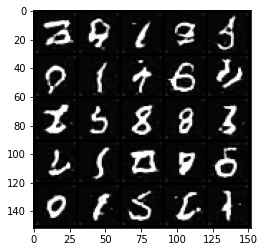

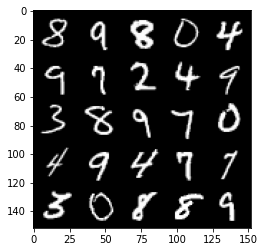

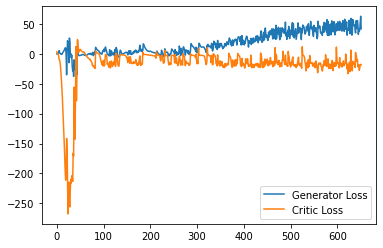

Step 13100: Generator loss: 45.91388387680054, critic loss: -13.957295525550842


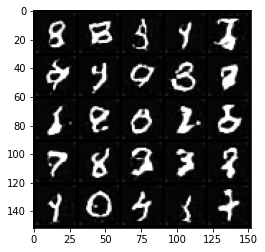

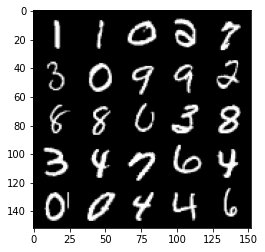

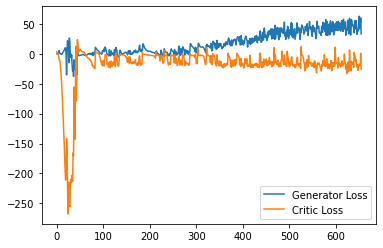

Step 13150: Generator loss: 50.50370445251465, critic loss: -6.615852446556091


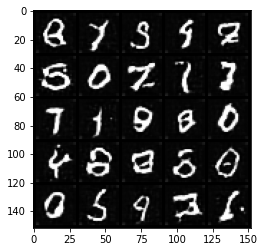

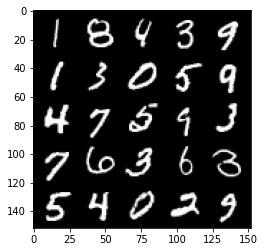

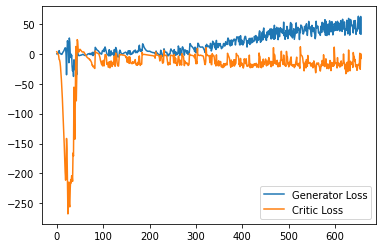

Step 13200: Generator loss: 46.73157550811768, critic loss: -14.61571586728096


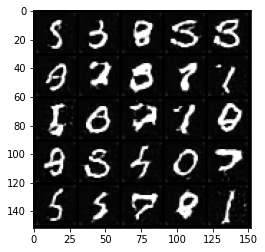

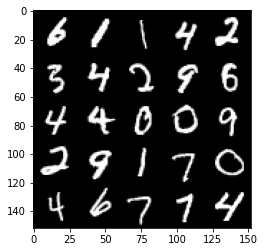

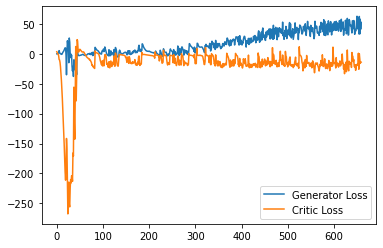

Step 13250: Generator loss: 52.36955425262451, critic loss: -16.553127296447755


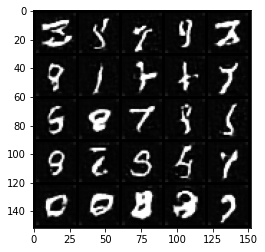

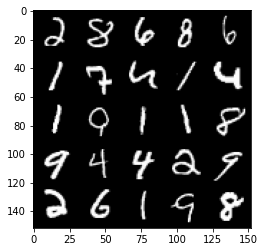

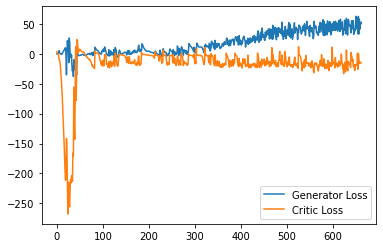

Step 13300: Generator loss: 43.935255737304686, critic loss: -18.99906280374527


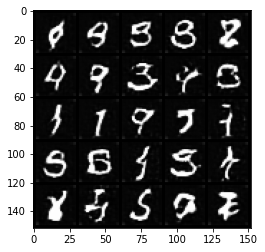

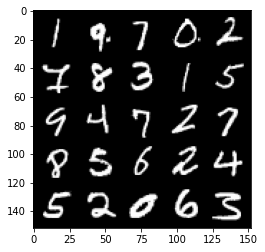

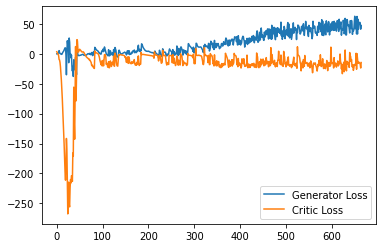

Step 13350: Generator loss: 50.973037261962894, critic loss: -10.116843257904051


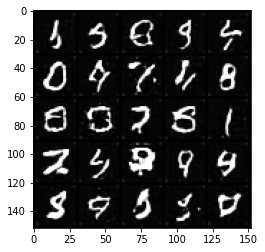

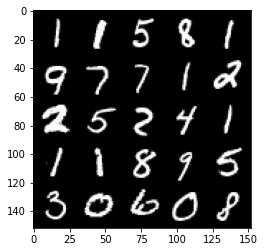

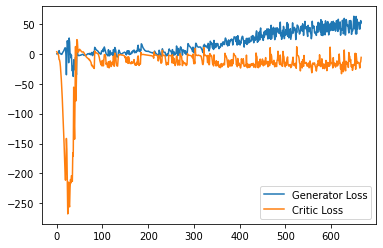

Step 13400: Generator loss: 41.153058555126194, critic loss: -21.937383070468908


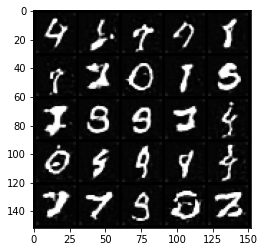

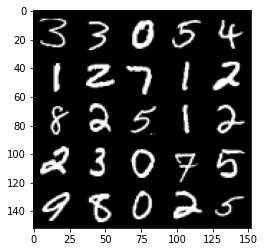

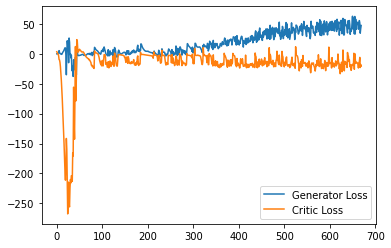

Step 13450: Generator loss: 47.07198501586914, critic loss: -16.623181293010713


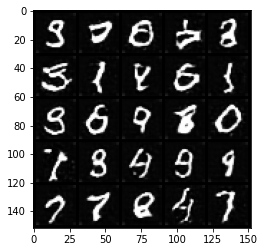

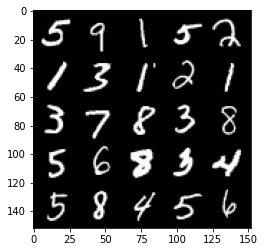

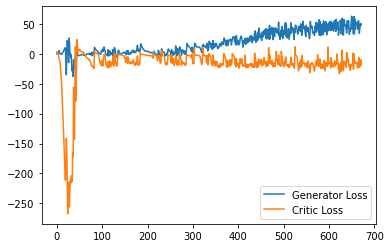

Step 13500: Generator loss: 54.56100399017334, critic loss: -17.496582304954526


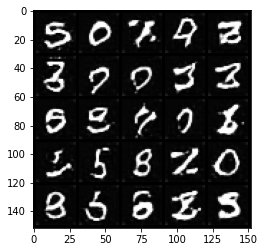

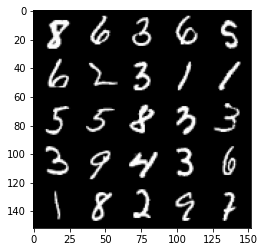

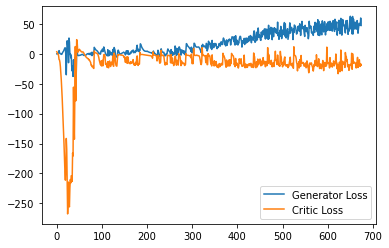

Step 13550: Generator loss: 45.838923377990724, critic loss: -16.554984994173047


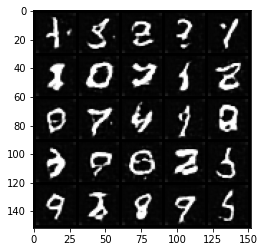

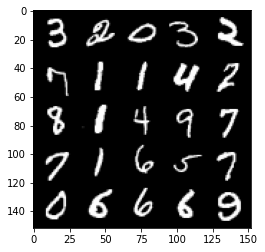

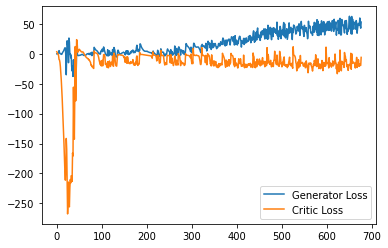

Step 13600: Generator loss: 51.03161647796631, critic loss: -21.15979649066925


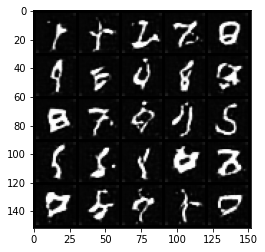

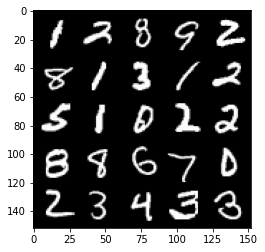

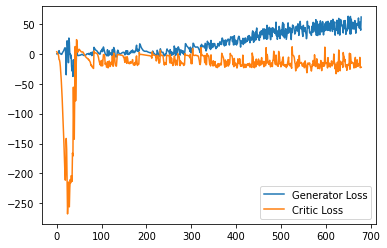

Step 13650: Generator loss: 39.57279113769531, critic loss: -18.27096335887909


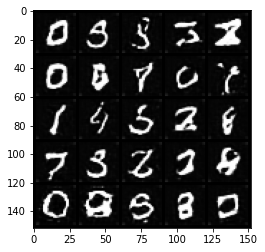

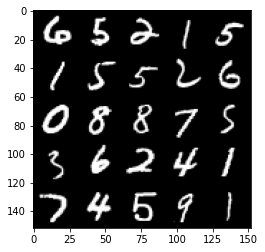

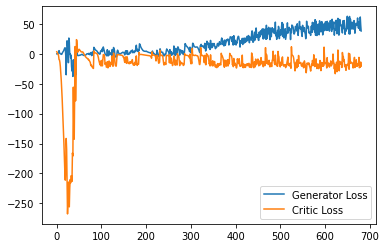

Step 13700: Generator loss: 50.68465074539185, critic loss: -15.357838171958923


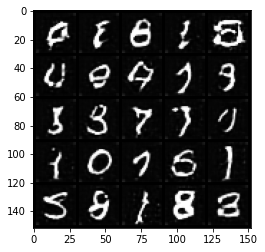

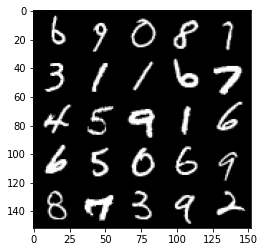

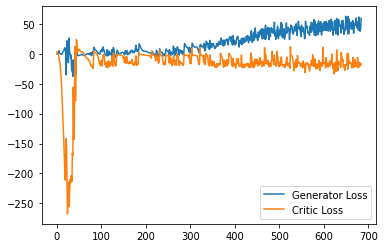

Step 13750: Generator loss: 43.46436088562012, critic loss: -21.12108309388161


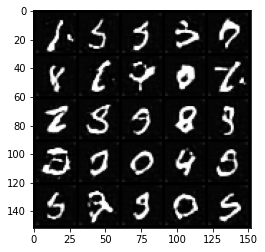

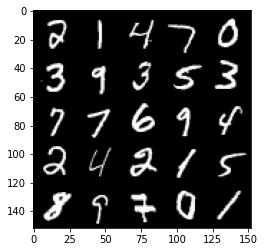

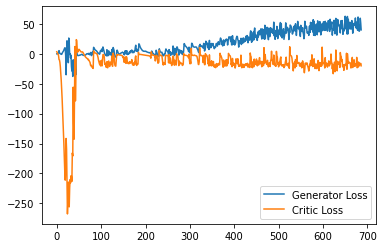

Step 13800: Generator loss: 47.02812128067016, critic loss: -12.81994942855835


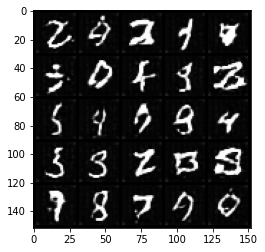

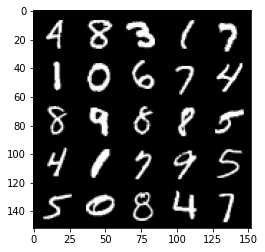

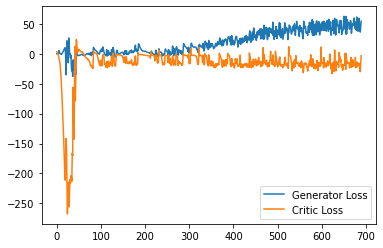

Step 13850: Generator loss: 46.28390148162842, critic loss: -16.957396287918094


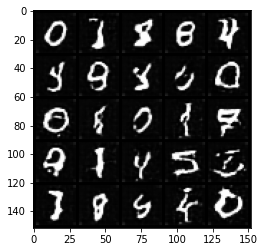

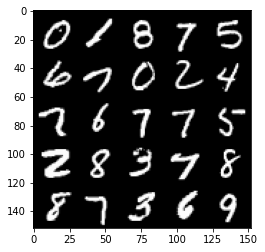

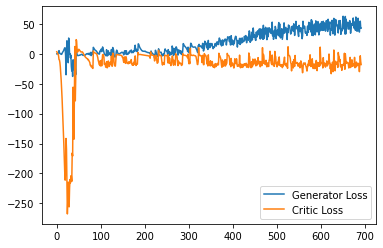

Step 13900: Generator loss: 46.52900291442871, critic loss: -19.40945145225525


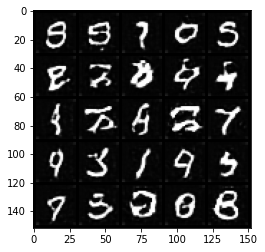

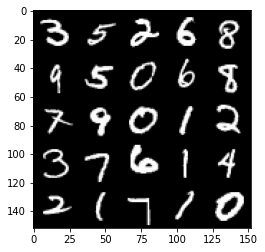

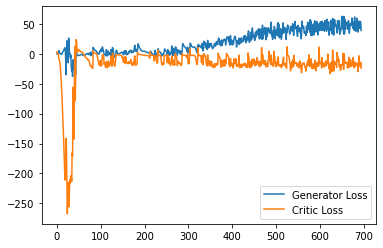

Step 13950: Generator loss: 55.62992282867432, critic loss: -13.132056287884708


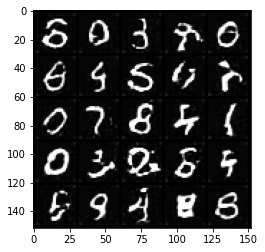

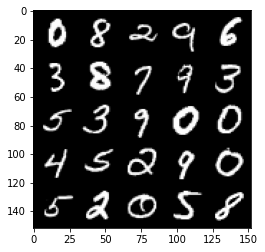

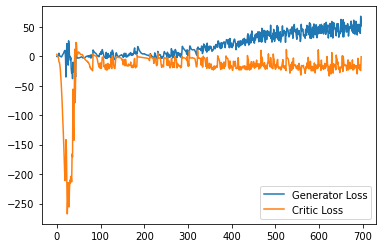

Step 14000: Generator loss: 43.504522037506106, critic loss: -11.609403676986695


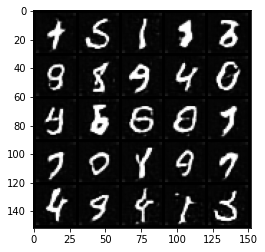

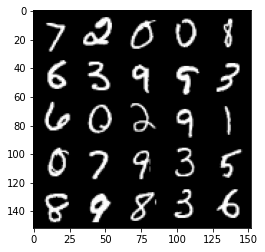

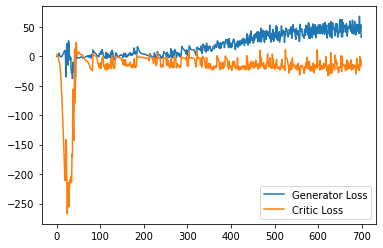

Step 14050: Generator loss: 59.93424518585205, critic loss: -19.691716704368595


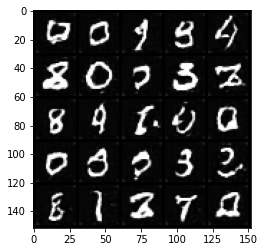

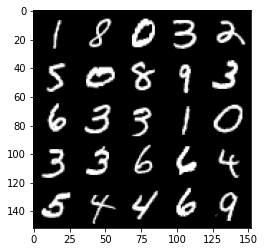

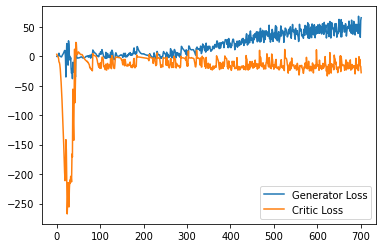

Step 14100: Generator loss: 45.94806270599365, critic loss: -15.527184130191806


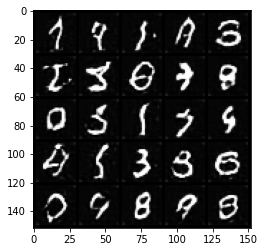

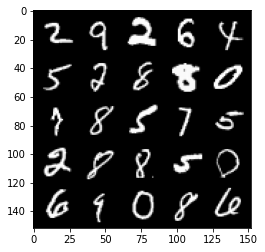

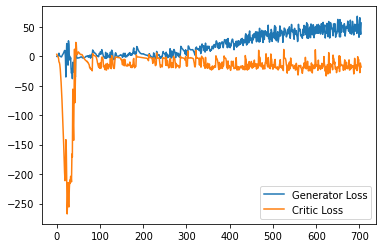

Step 14150: Generator loss: 43.61839727401733, critic loss: -19.013775428771968


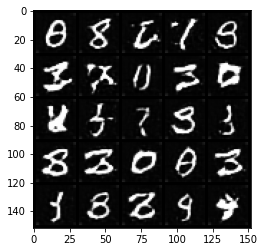

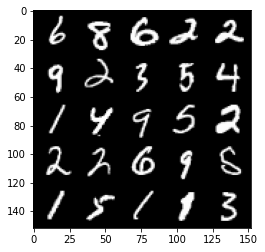

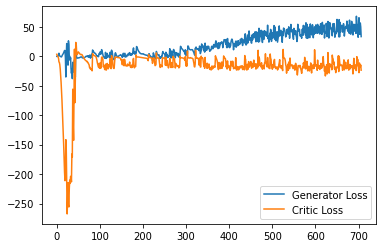

Step 14200: Generator loss: 50.016473617553714, critic loss: 1.072864990234376


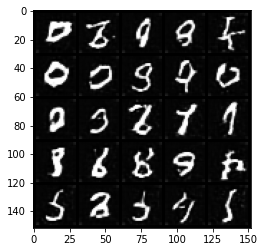

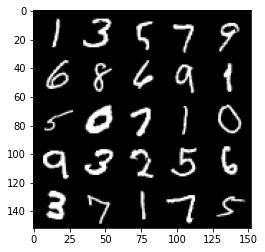

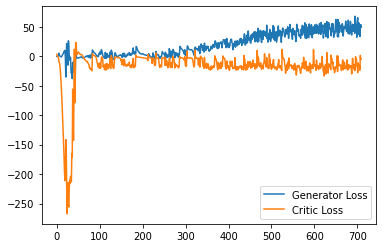

Step 14250: Generator loss: 41.48167055130005, critic loss: -20.492761426925657


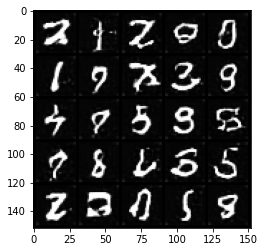

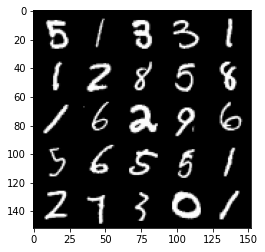

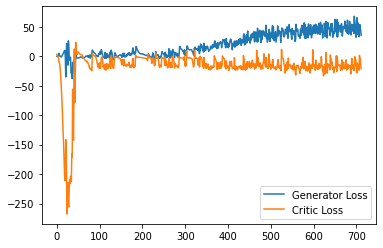

Step 14300: Generator loss: 38.87749400138855, critic loss: -22.7227501809597


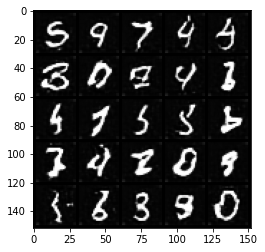

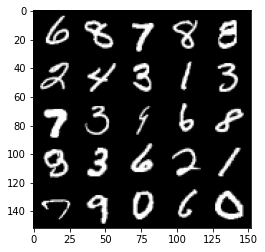

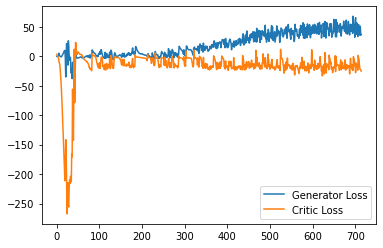

Step 14350: Generator loss: 48.84057935714722, critic loss: -18.509318861007692


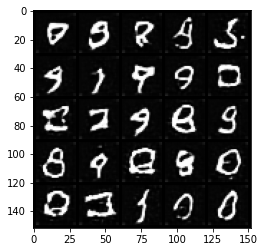

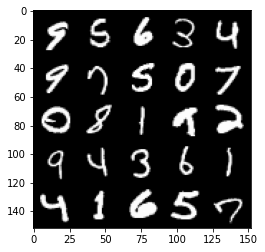

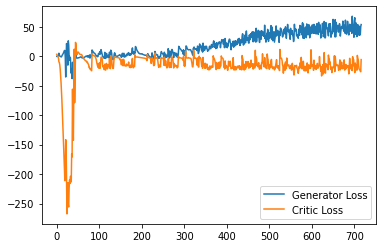

Step 14400: Generator loss: 53.1702367401123, critic loss: -10.510463959693912


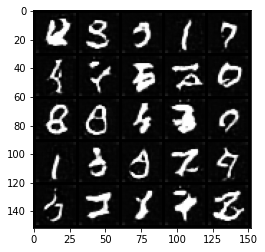

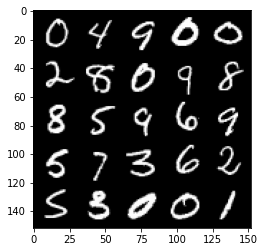

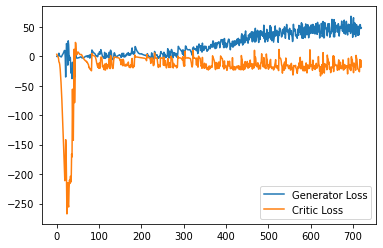

Step 14450: Generator loss: 45.62511636734009, critic loss: -14.582722705364226


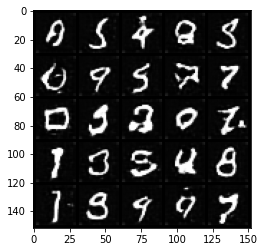

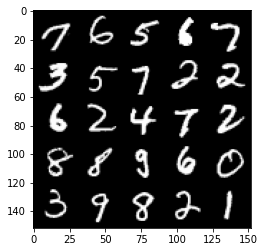

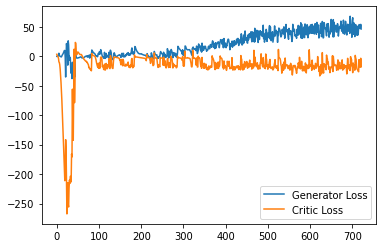

Step 14500: Generator loss: 54.87167495727539, critic loss: -16.309834032535555


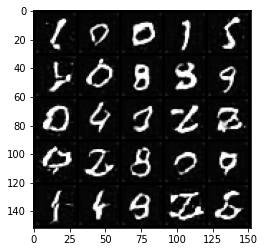

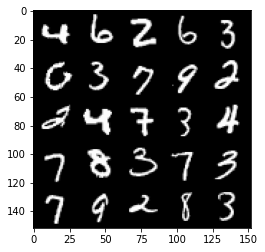

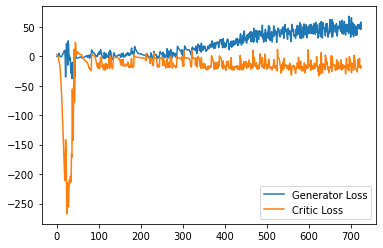

Step 14550: Generator loss: 49.488339538574216, critic loss: -18.710181518554688


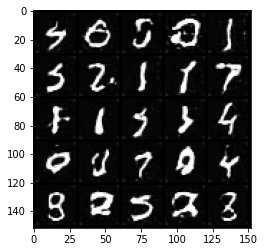

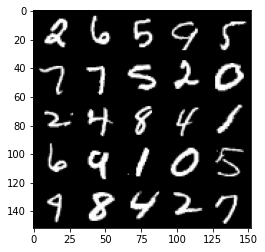

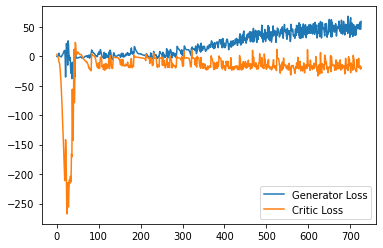

Step 14600: Generator loss: 43.04167667388916, critic loss: -12.37241152048111


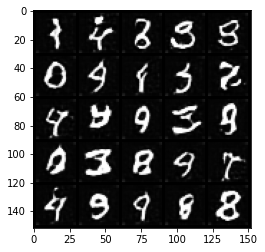

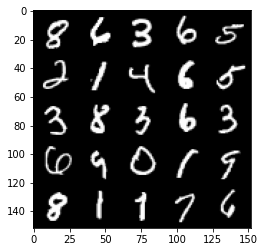

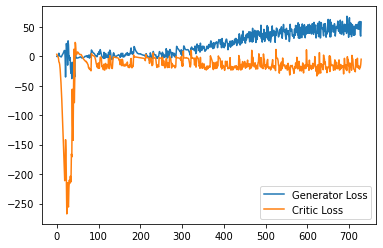

Step 14650: Generator loss: 54.47604690551758, critic loss: -18.340375625133515


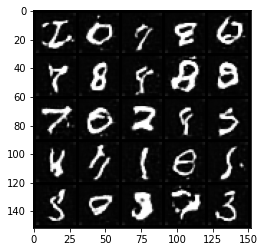

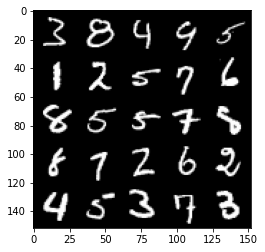

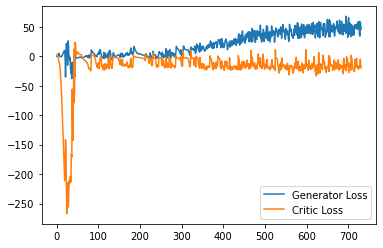

Step 14700: Generator loss: 49.52042552947998, critic loss: -15.526611157417294


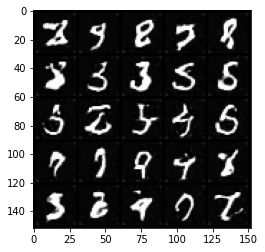

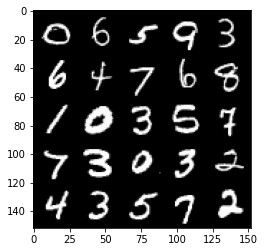

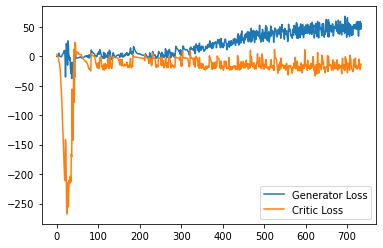

Step 14750: Generator loss: 48.159431505203244, critic loss: -15.976695854902271


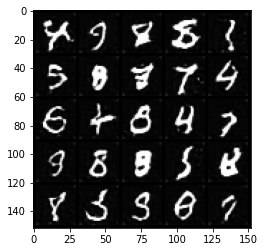

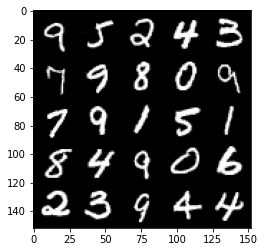

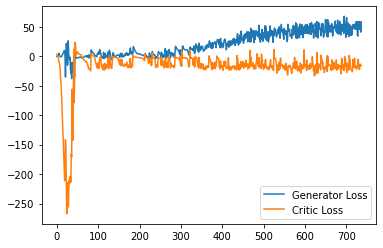

Step 14800: Generator loss: 47.76662696838379, critic loss: -15.969972233057021


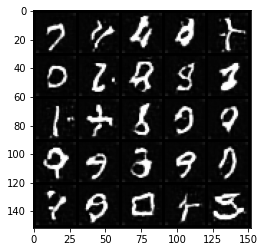

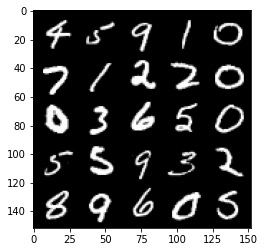

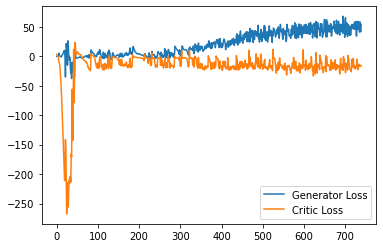

Step 14850: Generator loss: 49.29152122497558, critic loss: -13.54501834058762


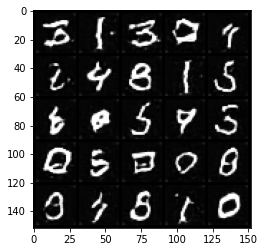

Step 15250: Generator loss: 54.62986946105957, critic loss: -19.844898236274723


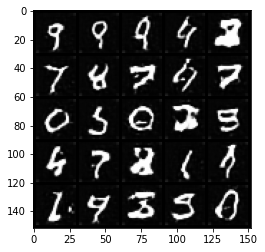

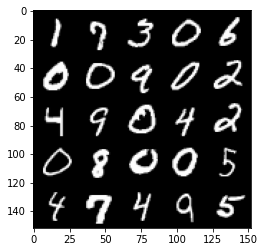

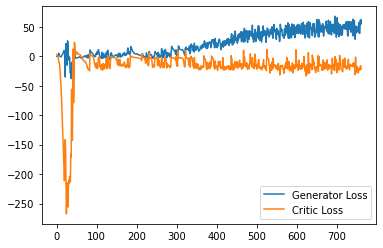

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
